In [1]:
import requests
from selenium import webdriver
from bs4 import BeautifulSoup
import time
import pandas as pd
import numpy as np
from selenium.webdriver.common.by import By
from lxml import html



In [5]:
Company=[]
Title=[]
Exp=[]
Salary=[]
Workmode=[]
location=[]
posted=[]
Qualification=[]


In [ ]:
pages = np.arange(1,31)
dff = pd.DataFrame(columns=['Job Title', 'Company','URL','Experience','Workmode','Location','Qualification','Posted'])


for pages1 in pages:
    url = "https://www.naukri.com/jobs-in-india-"+str(pages1)+"?clusters=qbusinessSize&qbusinessSize=211&qbusinessSize=213&qbusinessSize=217"
  

    page = requests.get(url)
  # print(page.text)

  # Making the Driver Headless: (next 3 lines)
    driver = webdriver.Chrome()
    driver.headless = True

  #time.sleep(3)

  
    driver.get(url)
  
    time.sleep(5)
    soup = BeautifulSoup(driver.page_source,'html.parser')

  # print(soup.prettify())

    driver.close()
  
    
    results = soup.find(class_='list')

    job_elems=results.find_all('article', class_='jobTuple')


    for job_elem in job_elems:
    
        #URL = job_elem.find('a',class_='title ellipsis').get('href')
        #Url.append(URL)
    

        T = job_elem.find('a',class_='title ellipsis')
        Title.append(T.text)

        C = job_elem.find('a', class_='subTitle ellipsis fleft')
        Company.append(C.text)
    # print("Company: " + Company.text)

        E = job_elem.find('span', class_='ellipsis fleft expwdth')
        Exp.append(E.text)
    # print('Experience: ' + Exp.text)
    # print(" "*2)

        H= job_elem.find('span', class_='fleft postedDate')
        posted.append(H.text)
    
        s= job_elem.find('span', class_='ellipsis fleft')
        Salary.append(s.text)
    
        l= job_elem.find('li', class_='fleft br2 placeHolderLi location')
        location.append(l.text)
    
        Q= job_elem.find("div", class_='ellipsis job-description')
        Qualification.append(str(Q.text))
    
    
    
    
    
    

    # df=df.append({'Title':Title, 'Company':Company,'URL':URL}, ignore_index = True)
    # df = pd.DataFrame([[Title, Company, URL]], columns=['Title','Company','URL'])
    dff =pd.DataFrame({"Title":Title,
                       "Company":Company,
                       "Expereince":Exp,
                       "Salary":Salary,
                       "Location":location,
                       "Qualification":Qualification,
                       "Posted": posted})

In [6]:
import csv

In [ ]:
dff.to_csv("naukri4.csv", index = False)
print(dff)

In [2]:
df3=pd.read_csv("naukri4.csv")

In [3]:
df3.head()

,Title,Company,Expereince,Salary,Location,Qualification,Posted
0,Bpm Consultant- Pan India,Tech Mahindra,3-8 Yrs,Not disclosed,"Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...",We are looking for BPM Consultant- Pan India ...,1 Day Ago
1,"Tech Mahindra is hiring For ""ETL Lead""",Tech Mahindra,10-20 Yrs,Not disclosed,"Kolkata, Hyderabad/Secunderabad, Pune, Ahmedab...",Kindly go through the below JD & please apply...,1 Day Ago
2,Hiring For Site Reliability Engineer- Pan India,Tech Mahindra,8-13 Yrs,11-21 Lacs PA,"Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...",Experience with designing and measuring servi...,2 Days Ago
3,Scrum Master,Wipro,10-16 Yrs,Not disclosed,"Noida, Uttar Pradesh, Kolkata, Hyderabad/ Secu...",Preparing and presenting status reports to st...,2 Days Ago
4,SAP FICO with Treasury _ Tech M_ PAN India,Tech Mahindra,7-12 Yrs,25-30 Lacs PA,"Hybrid - Noida, Uttar Pradesh, Hyderabad/ Secu...",Must Have: Years of Experience: 7+ YearsShoul...,1 Day Ago


In [4]:
df3.shape

(1140, 7)

In [5]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1140 entries, 0 to 1139
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Title          1140 non-null   object
 1   Company        1140 non-null   object
 2   Expereince     1140 non-null   object
 3   Salary         1140 non-null   object
 4   Location       1140 non-null   object
 5   Qualification  1140 non-null   object
 6   Posted         1140 non-null   object
dtypes: object(7)
memory usage: 62.5+ KB


In [6]:
df3.describe()

,Title,Company,Expereince,Salary,Location,Qualification,Posted
count,1140,1140,1140,1140,1140,1140,1140
unique,554,92,73,37,172,527,33
top,SAP Vendor Invoice Management Application Lead,Tata Motors Finance,5-10 Yrs,Not disclosed,"Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...",Be responsible for integration with different...,30+ Days Ago
freq,10,200,86,1023,432,33,205


In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
display(df3.dtypes)

Title            object
Company          object
Expereince       object
Salary           object
Location         object
Qualification    object
Posted           object
dtype: object

In [6]:
df3=df3.astype({"Title":"str","Company":"str","Location":"str","Qualification":"str"})

In [7]:
display(df3.dtypes)

Title            object
Company          object
Expereince       object
Salary           object
Location         object
Qualification    object
Posted           object
dtype: object

In [8]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1140 entries, 0 to 1139
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Title          1140 non-null   object
 1   Company        1140 non-null   object
 2   Expereince     1140 non-null   object
 3   Salary         1140 non-null   object
 4   Location       1140 non-null   object
 5   Qualification  1140 non-null   object
 6   Posted         1140 non-null   object
dtypes: object(7)
memory usage: 62.5+ KB


In [9]:
import plotly.express as px

In [10]:
fig = px.bar(df3,"Title")
fig.show()

In [11]:
df3.columns

Index(['Title', 'Company', 'Expereince', 'Salary', 'Location', 'Qualification',
       'Posted'],
      dtype='object')

In [12]:
df3["Title"].value_counts()

SAP Vendor Invoice Management Application Lead                  10
IT Technologist                                                  7
HCL Hiring Tibco BW 5.x , 6.x Development & Support || Aug-5     7
Matillion and Snowflake Developer with Hexaware!!!               7
Rpa Project Manager UiPath                                       7
                                                                ..
LGBTQ+ Focused Role                                              1
Deputy Manager - Pkg Engg                                        1
IT Head Count Analyst                                            1
Senior Associate                                                 1
Senior Manager (L5) Customer Quality                             1
Name: Title, Length: 554, dtype: int64

In [13]:
df3["Title"].unique()

array(['Bpm Consultant- Pan India',
       'Tech Mahindra is hiring For "ETL Lead"',
       'Hiring For Site Reliability Engineer- Pan India', 'Scrum Master',
       'SAP FICO with Treasury _ Tech M_ PAN India',
       'Java Full Stack Developer_ Tech Mahindra_ PAN India',
       "Probationary Officers' Programme",
       'Pega Developer, Leads, Architects || PAN India || 5-Aug drive',
       'Digital UX Lead (Figma) _ Tech M (PAN India)', 'Perl Developer',
       'HCL Hiring Tibco BW 5.x , 6.x Development & Support || Aug-5',
       'Sr. Java Full Stack Developer_ Tech Mahindra_ PAN India',
       'Sr. Angular Developer', 'Sap Abap Consultant',
       'Birlasoft is hiring Generative AI Lead/Architect',
       'Azure Data Factory Developer -ADF', 'Rpa Project Manager UiPath',
       'Matillion and Snowflake Developer with Hexaware!!!',
       'Job Opportunity For AWS Datalake with Hexaware!!!',
       'IT Technologist', 'NEVA- NICE Developer',
       'CN - Retail - SAP Platforms - Cons

In [14]:
df3["Company"].value_counts()

Tata Motors Finance    200
Accenture              149
Tech Mahindra           85
Capgemini               60
Cognizant               55
                      ... 
Coforge                  1
Jacobs                   1
ABP Empower              1
WNS Holdings             1
Pine Labs                1
Name: Company, Length: 92, dtype: int64

In [15]:
df3["Salary"].value_counts()

Not disclosed       1023
25-30 Lacs PA         12
15-20 Lacs PA          9
7-14 Lacs PA           7
27.5-30 Lacs PA        7
4.25-4.5 Lacs PA       7
8-18 Lacs PA           6
11-21 Lacs PA          5
12-18 Lacs PA          4
9-19 Lacs PA           4
3-6 Lacs PA            4
10-20 Lacs PA          3
2-2.75 Lacs PA         2
15-30 Lacs PA          2
3-8 Lacs PA            2
6-15 Lacs PA           2
5-12 Lacs PA           2
9.5-19.5 Lacs PA       2
2-6.5 Lacs PA          2
22.5-25 Lacs PA        2
4-6 Lacs PA            2
60,000-3 Lacs PA       2
8-17 Lacs PA           2
3.5-8.5 Lacs PA        2
17-22.5 Lacs PA        2
12-19 Lacs PA          2
1-5 Lacs PA            2
1.5-3.75 Lacs PA       2
2-4.5 Lacs PA          2
2-3.5 Lacs PA          2
6-12 Lacs PA           2
18-33 Lacs PA          2
15-27.5 Lacs PA        2
12-22 Lacs PA          2
15-25 Lacs PA          2
25-35 Lacs PA          2
6-16 Lacs PA           1
Name: Salary, dtype: int64

In [16]:
df3["Posted"].value_counts()

30+ Days Ago     205
2 Days Ago       151
1 Day Ago         92
4 Days Ago        79
12 Days Ago       60
3 Days Ago        60
10 Days Ago       48
9 Days Ago        44
5 Days Ago        40
11 Days Ago       39
8 Days Ago        34
13 Days Ago       33
7 Days Ago        25
19 Days Ago       24
30 Days Ago       23
6 Days Ago        18
23 Days Ago       18
22 Days Ago       17
14 Days Ago       16
15 Days Ago       16
25 Days Ago       16
17 Days Ago       15
26 Days Ago       12
24 Days Ago       12
18 Days Ago       11
16 Days Ago        6
20 Days Ago        6
21 Days Ago        6
29 Days Ago        4
Just Now           4
Today              2
Few Hours Ago      2
27 Days Ago        2
Name: Posted, dtype: int64

In [17]:
df3["Location"].value_counts()

Kolkata, Mumbai, New Delhi, Hyderabad/Secunderabad, Pune, Chennai, Bangalore/Bengaluru                                                                  432
Kolkata, Hyderabad/Secunderabad, Pune, Ahmedabad, Chennai, Bangalore/Bengaluru, Delhi / NCR, Mumbai (All Areas)                                          34
Hybrid - Kolkata, Hyderabad/Secunderabad, Pune, Ahmedabad, Chennai, Bangalore/Bengaluru, Delhi / NCR, Mumbai (All Areas)                                 27
Hybrid - Kolkata, Hyderabad/Secunderabad, Pune, Chennai, Bangalore/Bengaluru, Delhi / NCR, Mumbai (All Areas)                                            27
Hybrid - Pune, Maharashtra, Chennai, Tamil Nadu, Bangalore/ Bengaluru, Karnataka, Mumbai (All Areas)                                                     19
                                                                                                                                                       ... 
Mumbai, New Delhi, Hyderabad/Secunderabad, Pune, Gurgaon/Gurugra

In [19]:
d1=df3.groupby("Title")

In [22]:
for i in df3["Title"]:
    g=d1.get_group(i)
   
    print(i)
    print(g)    

Bpm Consultant- Pan India
                         Title        Company Expereince         Salary  \
0    Bpm Consultant- Pan India  Tech Mahindra    3-8 Yrs  Not disclosed   
480  Bpm Consultant- Pan India  Tech Mahindra    3-8 Yrs  Not disclosed   
500  Bpm Consultant- Pan India  Tech Mahindra    3-8 Yrs  Not disclosed   
520  Bpm Consultant- Pan India  Tech Mahindra    3-8 Yrs  Not disclosed   
540  Bpm Consultant- Pan India  Tech Mahindra    3-8 Yrs  Not disclosed   

                                              Location  \
0    Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
480  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
500  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
520  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
540  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   

                                         Qualification     Posted  
0     We are looking for BPM Consultant- Pan India ...  1 Day Ago  
480   We are looking for BPM Consultan

                       Title              Company Expereince         Salary  \
52   TSM-Institutional Sales  Tata Motors Finance    5-6 Yrs  Not disclosed   
592  TSM-Institutional Sales  Tata Motors Finance    5-6 Yrs  Not disclosed   

                                              Location  \
52   Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
592  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                         Qualification      Posted  
52    BE / B Tech . Master of Business Administrati...  2 Days Ago  
592   BE / B Tech . Master of Business Administrati...  2 Days Ago  
Senior Manager - TSM CV Passenger
                                 Title              Company Expereince  \
53   Senior Manager - TSM CV Passenger  Tata Motors Finance    4-7 Yrs   
593  Senior Manager - TSM CV Passenger  Tata Motors Finance    4-7 Yrs   

            Salary                                           Location  \
53   Not disclosed  Kolkata, Mumbai, New Delhi, Hy

                                                 Title    Company Expereince  \
105  CN - Strategy - MC - SC&O - SC Digital Core Or...  Accenture    4-8 Yrs   
645  CN - Strategy - MC - SC&O - SC Digital Core Or...  Accenture    4-8 Yrs   

            Salary                                           Location  \
105  Not disclosed  Mumbai, Pune, Gurgaon/Gurugram, Delhi / NCR, B...   
645  Not disclosed  Mumbai, Pune, Gurgaon/Gurugram, Delhi / NCR, B...   

                                         Qualification      Posted  
105   Practice: Supply Chain and Operations, Indust...  4 Days Ago  
645   Practice: Supply Chain and Operations, Indust...  4 Days Ago  
CN - Strategy - MC - SC&O - SC Digital Core Oracle - 06
                                                 Title    Company Expereince  \
106  CN - Strategy - MC - SC&O - SC Digital Core Or...  Accenture   8-12 Yrs   
646  CN - Strategy - MC - SC&O - SC Digital Core Or...  Accenture   8-12 Yrs   

            Salary                 

                                                 Title   Company Expereince  \
153  Oracle Cloud SCM Functional Professional's - M...  Deloitte    3-7 Yrs   
693  Oracle Cloud SCM Functional Professional's - M...  Deloitte    3-7 Yrs   

            Salary                                           Location  \
153  Not disclosed  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
693  Not disclosed  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   

                                         Qualification       Posted  
153   Highest Qualification: Any BE / B Tech or Any...  12 Days Ago  
693   Highest Qualification: Any BE / B Tech or Any...  12 Days Ago  
Alfresco + Java Developer
                         Title    Company Expereince         Salary  \
154  Alfresco + Java Developer  Cognizant   7-12 Yrs  Not disclosed   
694  Alfresco + Java Developer  Cognizant   7-12 Yrs  Not disclosed   

                                              Location  \
154  Kolkata, Hyderabad/Secunderab

                     Title     Company Expereince         Salary  \
213  Technical Lead - .Net  Citiustech   5-10 Yrs  Not disclosed   
753  Technical Lead - .Net  Citiustech   5-10 Yrs  Not disclosed   

                                              Location  \
213  Mumbai, Hyderabad/Secunderabad, Pune, Chennai,...   
753  Mumbai, Hyderabad/Secunderabad, Pune, Chennai,...   

                                         Qualification       Posted  
213   Participate in the testing process through te...  12 Days Ago  
753   Participate in the testing process through te...  12 Days Ago  
Portfolio Support Specialist
                            Title  Company Expereince         Salary  \
214  Portfolio Support Specialist  Pearson    2-7 Yrs  Not disclosed   
754  Portfolio Support Specialist  Pearson    2-7 Yrs  Not disclosed   

                                              Location  \
214  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
754  Kolkata, Mumbai, New Delhi, Hyderabad/Secun

             Title Company Expereince         Salary  \
263  Legal Counsel     IBM  13-17 Yrs  Not disclosed   
803  Legal Counsel     IBM  13-17 Yrs  Not disclosed   

                                     Location  \
263  Mumbai, Bangalore/Bengaluru, Delhi / NCR   
803  Mumbai, Bangalore/Bengaluru, Delhi / NCR   

                                         Qualification      Posted  
263   Your Role and ResponsibilitiesJob Description...  2 Days Ago  
803   Your Role and ResponsibilitiesJob Description...  2 Days Ago  
Marketing Executive
                   Title       Company Expereince       Salary  \
264  Marketing Executive  Ion Exchange    2-7 Yrs  1-5 Lacs PA   
804  Marketing Executive  Ion Exchange    2-7 Yrs  1-5 Lacs PA   

                                              Location  \
264  Bangalore/ Bengaluru, Karnataka, Vadodara/ Bar...   
804  Bangalore/ Bengaluru, Karnataka, Vadodara/ Bar...   

                                         Qualification      Posted  
264   Candida

                                Title    Company Expereince         Salary  \
327  Endpoint Management Professional  Capgemini    6-9 Yrs  Not disclosed   
867  Endpoint Management Professional  Capgemini    6-9 Yrs  Not disclosed   

                              Location  \
327  Mumbai, Pune, Bangalore/Bengaluru   
867  Mumbai, Pune, Bangalore/Bengaluru   

                                         Qualification       Posted  
327   5+ years experience working with PC/Mac infra...  15 Days Ago  
867   5+ years experience working with PC/Mac infra...  15 Days Ago  
ELK Implementer /Administrator
                              Title    Company Expereince         Salary  \
328  ELK Implementer /Administrator  Capgemini   9-12 Yrs  Not disclosed   
868  ELK Implementer /Administrator  Capgemini   9-12 Yrs  Not disclosed   

                              Location  \
328  Mumbai, Pune, Bangalore/Bengaluru   
868  Mumbai, Pune, Bangalore/Bengaluru   

                                         

                                                 Title    Company Expereince  \
378  Cognizant_Azure Devops, Azure Kubernetes Servi...  Cognizant  10-20 Yrs   
918  Cognizant_Azure Devops, Azure Kubernetes Servi...  Cognizant  10-20 Yrs   

            Salary                                           Location  \
378  Not disclosed  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
918  Not disclosed  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   

                                         Qualification       Posted  
378   Hands-on Strong experience in Azure technolog...  15 Days Ago  
918   Hands-on Strong experience in Azure technolog...  15 Days Ago  
Cognizant-Azure Infra with Infrastructure Automation(Terraform,ARM
                                                 Title    Company Expereince  \
379  Cognizant-Azure Infra with Infrastructure Auto...  Cognizant   5-10 Yrs   
919  Cognizant-Azure Infra with Infrastructure Auto...  Cognizant   5-10 Yrs   

            Salary   

                                          Title    Company Expereince  \
431  Capgemini Hiring_MS Dynamics CRM Developer  Capgemini    3-8 Yrs   
971  Capgemini Hiring_MS Dynamics CRM Developer  Capgemini    3-8 Yrs   

            Salary                                           Location  \
431  Not disclosed  Kolkata, Mumbai, Maharashtra, Hyderabad/Secund...   
971  Not disclosed  Kolkata, Mumbai, Maharashtra, Hyderabad/Secund...   

                                         Qualification       Posted  
431   Dear Candidate, . We came across your job pro...  24 Days Ago  
971   Dear Candidate, . We came across your job pro...  24 Days Ago  
Senior Manager (L5) - Finance
                             Title              Company Expereince  \
432  Senior Manager (L5) - Finance  Tata Motors Finance    5-7 Yrs   
972  Senior Manager (L5) - Finance  Tata Motors Finance    5-7 Yrs   

            Salary                                           Location  \
432  Not disclosed  Kolkata, Mumbai,

                                Title     Company Expereince  \
6    Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
55   Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
486  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
506  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
526  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
546  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
595  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   

               Salary                                           Location  \
6    4.25-4.5 Lacs PA  Kolkata, Hyderabad/Secunderabad, Pune, Ahmedab...   
55   4.25-4.5 Lacs PA  Kolkata, Hyderabad/Secunderabad, Pune, Ahmedab...   
486  4.25-4.5 Lacs PA  Kolkata, Hyderabad/Secunderabad, Pune, Ahmedab...   
506  4.25-4.5 Lacs PA  Kolkata, Hyderabad/Secunderabad, Pune, Ahmedab...   
526  4.25-4.5 Lacs PA  Kolkata, Hyderabad/Secunderabad, Pune, Ahmedab...   
546  4.25-4.5 Lacs PA  Kolkata,

                                               Title        Company  \
2    Hiring For Site Reliability Engineer- Pan India  Tech Mahindra   
482  Hiring For Site Reliability Engineer- Pan India  Tech Mahindra   
502  Hiring For Site Reliability Engineer- Pan India  Tech Mahindra   
522  Hiring For Site Reliability Engineer- Pan India  Tech Mahindra   
542  Hiring For Site Reliability Engineer- Pan India  Tech Mahindra   

    Expereince         Salary  \
2     8-13 Yrs  11-21 Lacs PA   
482   8-13 Yrs  11-21 Lacs PA   
502   8-13 Yrs  11-21 Lacs PA   
522   8-13 Yrs  11-21 Lacs PA   
542   8-13 Yrs  11-21 Lacs PA   

                                              Location  \
2    Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
482  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
502  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
522  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
542  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   

                         

                                     Title Company Expereince         Salary  \
58   Senior Coordinator, HR Shared Service    Ford    2-6 Yrs  Not disclosed   
598  Senior Coordinator, HR Shared Service    Ford    2-6 Yrs  Not disclosed   

                                              Location  \
58   Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
598  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                         Qualification      Posted  
58    Exposure to automation tools . Any Bachelor d...  3 Days Ago  
598   Exposure to automation tools . Any Bachelor d...  3 Days Ago  
Software Quality Engineer
                         Title          Company Expereince         Salary  \
59   Software Quality Engineer  NCR Corporation    5-7 Yrs  Not disclosed   
284  Software Quality Engineer  NCR Corporation    5-8 Yrs  Not disclosed   
599  Software Quality Engineer  NCR Corporation    5-7 Yrs  Not disclosed   
824  Software Quality Engineer  NCR Corpora

                                                 Title    Company Expereince  \
113  CN - Strategy - MC - SC&O - SC Digital Core IB...  Accenture    4-8 Yrs   
653  CN - Strategy - MC - SC&O - SC Digital Core IB...  Accenture    4-8 Yrs   

            Salary                                           Location  \
113  Not disclosed  Mumbai, Pune, Gurgaon/Gurugram, Bangalore/Beng...   
653  Not disclosed  Mumbai, Pune, Gurgaon/Gurugram, Bangalore/Beng...   

                               Qualification      Posted  
113   Foster good relationships with clients  5 Days Ago  
653   Foster good relationships with clients  5 Days Ago  
Azure Data Factory Developer -ADF
                                 Title                Company Expereince  \
15   Azure Data Factory Developer -ADF  Hexaware Technologies    4-7 Yrs   
114  Azure Data Factory Developer -ADF  Hexaware Technologies    4-7 Yrs   
495  Azure Data Factory Developer -ADF  Hexaware Technologies    4-7 Yrs   
515  Azure Data Factory 

         Title         Company Expereince         Salary  \
92   Associate             PwC    4-7 Yrs  Not disclosed   
159  Associate            Ford    1-3 Yrs  Not disclosed   
440  Associate  Grant Thornton    1-4 Yrs  Not disclosed   
632  Associate             PwC    4-7 Yrs  Not disclosed   
699  Associate            Ford    1-3 Yrs  Not disclosed   
980  Associate  Grant Thornton    1-4 Yrs  Not disclosed   

                                              Location  \
92   Kolkata, Mumbai, Hyderabad/Secunderabad, Banga...   
159  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
440  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
632  Kolkata, Mumbai, Hyderabad/Secunderabad, Banga...   
699  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
980  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                         Qualification       Posted  
92    Solid knowledge and experience of supervised,...   2 Days Ago  
159   1-3 years hands-on experie

                                                 Title    Company Expereince  \
201  CN - Sales Excellence - Topic Advisory - Senio...  Accenture   7-12 Yrs   
204  CN - Sales Excellence - Topic Advisory - Senio...  Accenture   7-12 Yrs   
741  CN - Sales Excellence - Topic Advisory - Senio...  Accenture   7-12 Yrs   
744  CN - Sales Excellence - Topic Advisory - Senio...  Accenture   7-12 Yrs   

            Salary                                           Location  \
201  Not disclosed  Mumbai, Hyderabad/Secunderabad, Pune, Gurgaon/...   
204  Not disclosed  Mumbai, Hyderabad/Secunderabad, Pune, Gurgaon/...   
741  Not disclosed  Mumbai, Hyderabad/Secunderabad, Pune, Gurgaon/...   
744  Not disclosed  Mumbai, Hyderabad/Secunderabad, Pune, Gurgaon/...   

                                         Qualification       Posted  
201   Be responsible for integration with different...  12 Days Ago  
204   Be responsible for integration with different...  12 Days Ago  
741   Be responsible fo

Mainframe Test Lead
                   Title    Company Expereince         Salary  \
240  Mainframe Test Lead  Cognizant    7-9 Yrs  Not disclosed   
780  Mainframe Test Lead  Cognizant    7-9 Yrs  Not disclosed   

                                              Location  \
240  Kolkata, Hyderabad/Secunderabad, Pune, Chennai...   
780  Kolkata, Hyderabad/Secunderabad, Pune, Chennai...   

                                         Qualification     Posted  
240   We will need 7-8+ years of experience resourc...  1 Day Ago  
780   We will need 7-8+ years of experience resourc...  1 Day Ago  
IDAM Technical Analyst
                      Title  Company Expereince         Salary  \
241  IDAM Technical Analyst  HCLTech    6-8 Yrs  Not disclosed   
781  IDAM Technical Analyst  HCLTech    6-8 Yrs  Not disclosed   

                                              Location  \
241  Hyderabad/Secunderabad, Pune, Chennai, Bangalo...   
781  Hyderabad/Secunderabad, Pune, Chennai, Bangalo...   

        

                                      Title Company Expereince         Salary  \
271  Scientific Business Manager - Oncology   Cipla    4-9 Yrs  Not disclosed   
811  Scientific Business Manager - Oncology   Cipla    4-9 Yrs  Not disclosed   

                                              Location  \
271  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
811  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                         Qualification      Posted  
271   4+ years of pharmaceutical sales experience i...  5 Days Ago  
811   4+ years of pharmaceutical sales experience i...  5 Days Ago  
Data Science - Market Mix Modelling - Senior Associate 2 - ANI
                                                 Title Company Expereince  \
272  Data Science - Market Mix Modelling - Senior A...     PwC   6-11 Yrs   
812  Data Science - Market Mix Modelling - Senior A...     PwC   6-11 Yrs   

            Salary                                           Location  \
272  N

                     Title                Company Expereince         Salary  \
313  Integration Architect  Hexaware Technologies  15-20 Yrs  15-30 Lacs PA   
853  Integration Architect  Hexaware Technologies  15-20 Yrs  15-30 Lacs PA   

                                              Location  \
313  Hybrid - Pune, Maharashtra, Bangalore Rural, K...   
853  Hybrid - Pune, Maharashtra, Bangalore Rural, K...   

                                         Qualification       Posted  
313   Warm Greetings from Hexaware Technologies...!...  10 Days Ago  
853   Warm Greetings from Hexaware Technologies...!...  10 Days Ago  
Practice Architect - Imaging
                            Title     Company Expereince         Salary  \
314  Practice Architect - Imaging  Citiustech  14-20 Yrs  Not disclosed   
854  Practice Architect - Imaging  Citiustech  14-20 Yrs  Not disclosed   

                                              Location  \
314  Hybrid - Mumbai, Maharashtra, Pune, Maharashtr...   
854  H

                       Title     Company Expereince         Salary  \
355  Sr. Front-End Developer  Fareportal    4-9 Yrs  Not disclosed   
895  Sr. Front-End Developer  Fareportal    4-9 Yrs  Not disclosed   

                                              Location  \
355  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
895  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                         Qualification      Posted  
355   Ability to work and thrive in a fast-paced en...  9 Days Ago  
895   Ability to work and thrive in a fast-paced en...  9 Days Ago  
Devops Engineer
               Title     Company Expereince         Salary  \
356  Devops Engineer  Fareportal    3-7 Yrs  Not disclosed   
896  Devops Engineer  Fareportal    3-7 Yrs  Not disclosed   

                                              Location  \
356  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
896  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                             

               Title           Company Expereince         Salary  \
398  ASIC Engineer 2  Juniper Networks    2-6 Yrs  Not disclosed   
938  ASIC Engineer 2  Juniper Networks    2-6 Yrs  Not disclosed   

                                              Location  \
398  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
938  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                         Qualification       Posted  
398   Perform micro-architecture and logic design t...  19 Days Ago  
938   Perform micro-architecture and logic design t...  19 Days Ago  
JavaScript Programmer
                     Title        Company Expereince         Salary  \
399  JavaScript Programmer  Tech Mahindra   7-12 Yrs  Not disclosed   
939  JavaScript Programmer  Tech Mahindra   7-12 Yrs  Not disclosed   

                                              Location  \
399  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
939  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   


Senior Manager (L5) - Finance
                             Title              Company Expereince  \
432  Senior Manager (L5) - Finance  Tata Motors Finance    5-7 Yrs   
972  Senior Manager (L5) - Finance  Tata Motors Finance    5-7 Yrs   

            Salary                                           Location  \
432  Not disclosed  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
972  Not disclosed  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                         Qualification        Posted  
432   Revenue Recognition of TSS Sales and Services...  30+ Days Ago  
972   Revenue Recognition of TSS Sales and Services...  30+ Days Ago  
Senior Manager (L5) - TSM - TMA
                               Title              Company Expereince  \
433  Senior Manager (L5) - TSM - TMA  Tata Motors Finance    3-6 Yrs   
973  Senior Manager (L5) - TSM - TMA  Tata Motors Finance    3-6 Yrs   

            Salary                                           Location  \
433 

                                               Title        Company  \
473   Urgent opening For Automation tester /6+ Years  Tech Mahindra   
1013  Urgent opening For Automation tester /6+ Years  Tech Mahindra   

     Expereince         Salary  \
473    6-11 Yrs  Not disclosed   
1013   6-11 Yrs  Not disclosed   

                                               Location  \
473   Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   
1013  Hybrid - Kolkata, Hyderabad/Secunderabad, Pune...   

                                          Qualification       Posted  
473    Automation Tester Cucumber for Java and Selen...  30 Days Ago  
1013   Automation Tester Cucumber for Java and Selen...  30 Days Ago  
HCL TECH - Hirring Java Full Stack with Angular Pune
                                                  Title  Company Expereince  \
474   HCL TECH - Hirring Java Full Stack with Angula...  HCLTech   5-10 Yrs   
1014  HCL TECH - Hirring Java Full Stack with Angula...  HCLTech   5-10 Yrs   

 

                                    Title              Company Expereince  \
1050  Senior Manager - Quality Operations  Tata Motors Finance  10-15 Yrs   

             Salary                                           Location  \
1050  Not disclosed  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                          Qualification        Posted  
1050   Manpower Planning Shift Scheduling This role ...  30+ Days Ago  
Senior Manager - Indoor Testing
                                Title              Company Expereince  \
1051  Senior Manager - Indoor Testing  Tata Motors Finance    3-6 Yrs   

             Salary                                           Location  \
1051  Not disclosed  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                          Qualification        Posted  
1051   Bachelor of Engineering Glyph works, Diadams,...  30+ Days Ago  
Module Leader - Closure and Mechanisms
                                       Ti

CN - Strategy - MC - T&O - Change Management Graphic Designer - 11
                                                  Title    Company Expereince  \
1091  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   
1125  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   

             Salary                                           Location  \
1091  Not disclosed  Mumbai, Hyderabad/Secunderabad, Pune, Gurgaon/...   
1125  Not disclosed  Mumbai, Hyderabad/Secunderabad, Pune, Gurgaon/...   

                                          Qualification       Posted  
1091   Change Management Graphic Designer- Analyst -...  16 Days Ago  
1125   Join our team in Talent Organization and find...  16 Days Ago  
Engineer - Engine Design
                         Title              Company Expereince         Salary  \
1092  Engineer - Engine Design  Tata Motors Finance    1-4 Yrs  Not disclosed   

                                               Location  \
1092  

                                                  Title    Company Expereince  \
1091  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   
1125  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   

             Salary                                           Location  \
1091  Not disclosed  Mumbai, Hyderabad/Secunderabad, Pune, Gurgaon/...   
1125  Not disclosed  Mumbai, Hyderabad/Secunderabad, Pune, Gurgaon/...   

                                          Qualification       Posted  
1091   Change Management Graphic Designer- Analyst -...  16 Days Ago  
1125   Join our team in Talent Organization and find...  16 Days Ago  
Sub-Module Team Leader (SMTL) - Software V&V
                                             Title              Company  \
1126  Sub-Module Team Leader (SMTL) - Software V&V  Tata Motors Finance   

     Expereince         Salary  \
1126  15-20 Yrs  Not disclosed   

                                               Location

In [23]:
d2=df3.groupby("Company")

In [25]:
for i in df3["Company"]:
    g=d2.get_group(i)
    print(i)
    print(g)    

Tech Mahindra
                                                  Title        Company  \
0                             Bpm Consultant- Pan India  Tech Mahindra   
1                Tech Mahindra is hiring For "ETL Lead"  Tech Mahindra   
2       Hiring For Site Reliability Engineer- Pan India  Tech Mahindra   
4            SAP FICO with Treasury _ Tech M_ PAN India  Tech Mahindra   
5     Java Full Stack Developer_ Tech Mahindra_ PAN ...  Tech Mahindra   
...                                                 ...            ...   
1013     Urgent opening For Automation tester /6+ Years  Tech Mahindra   
1018                  Digital Transformation Consultant  Tech Mahindra   
1096  BORN -XDS TechMahindra Company -Looking For MS...  Tech Mahindra   
1097                          D365 Technical Consultant  Tech Mahindra   
1098           GCP Data Engineer / Lead - Tech Mahindra  Tech Mahindra   

     Expereince           Salary  \
0       3-8 Yrs    Not disclosed   
1     10-20 Yrs    Not di

                                                  Title    Company Expereince  \
31                                           Splunk SME  Capgemini   9-12 Yrs   
42                       Salesforce Lightning Developer  Capgemini   7-12 Yrs   
69                            Servicenow Developer ITSM  Capgemini    6-9 Yrs   
75                                        CA Siteminder  Capgemini   5-10 Yrs   
85                                     Informatica IICS  Capgemini   5-10 Yrs   
88                                    Aws Data Engineer  Capgemini   8-13 Yrs   
96                                        AEM DEVELOPER  Capgemini    6-9 Yrs   
97                                     EDR professional  Capgemini    4-9 Yrs   
118                                           SAP Basis  Capgemini   9-12 Yrs   
219   Job Opportunity For BlueYonder WMS Senior Cons...  Capgemini   6-11 Yrs   
231                                 Azure AD Consultant  Capgemini   9-12 Yrs   
232                         

Capgemini
                                                  Title    Company Expereince  \
31                                           Splunk SME  Capgemini   9-12 Yrs   
42                       Salesforce Lightning Developer  Capgemini   7-12 Yrs   
69                            Servicenow Developer ITSM  Capgemini    6-9 Yrs   
75                                        CA Siteminder  Capgemini   5-10 Yrs   
85                                     Informatica IICS  Capgemini   5-10 Yrs   
88                                    Aws Data Engineer  Capgemini   8-13 Yrs   
96                                        AEM DEVELOPER  Capgemini    6-9 Yrs   
97                                     EDR professional  Capgemini    4-9 Yrs   
118                                           SAP Basis  Capgemini   9-12 Yrs   
219   Job Opportunity For BlueYonder WMS Senior Cons...  Capgemini   6-11 Yrs   
231                                 Azure AD Consultant  Capgemini   9-12 Yrs   
232               

                                                  Title    Company Expereince  \
21             CN - Retail - SAP Platforms - Consultant  Accenture    2-7 Yrs   
22       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
23    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
24       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
25    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
...                                                 ...        ...        ...   
1063   CN - Strategy - SONG - ACE - Amazon Connect - 11  Accenture    2-7 Yrs   
1088   CN - Comms & Media - Media & Gaming - Consultant  Accenture    1-6 Yrs   
1091  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   
1119    CN - Comms & Media - SAP Platforms - Consultant  Accenture    2-7 Yrs   
1125  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   

             Salary        

                                                  Title      Company  \
35    Senior Associate / Assistant Manager - ISPL OP...  BNP Paribas   
140                  Associate WM Client Reference Data  BNP Paribas   
167                              Actimize SAM Developer  BNP Paribas   
380                  Associate WM Client Reference Data  BNP Paribas   
409                                                  AM  BNP Paribas   
413          F2B EQD Java Developer - Software Engineer  BNP Paribas   
414            Associate Level 1/Sr. Associate - AML L1  BNP Paribas   
575   Senior Associate / Assistant Manager - ISPL OP...  BNP Paribas   
680                  Associate WM Client Reference Data  BNP Paribas   
707                              Actimize SAM Developer  BNP Paribas   
920                  Associate WM Client Reference Data  BNP Paribas   
949                                                  AM  BNP Paribas   
953          F2B EQD Java Developer - Software Engineer  BNP Par

                                                 Title              Company  \
33    Senior Manager - Territory Sales Manager - ILMCV  Tata Motors Finance   
34                         Manager HR & Administration  Tata Motors Finance   
52                             TSM-Institutional Sales  Tata Motors Finance   
53                   Senior Manager - TSM CV Passenger  Tata Motors Finance   
56               Senior Manager - SAP SuccessFactor EC  Tata Motors Finance   
...                                                ...                  ...   
1135                 Sr. Manager - Powertrain Delivery  Tata Motors Finance   
1136              SMTE System and Logical Architecture  Tata Motors Finance   
1137                            SMTE MBSE Professional  Tata Motors Finance   
1138            SMTE Communication Design Professional  Tata Motors Finance   
1139              Senior Manager (L5) Customer Quality  Tata Motors Finance   

     Expereince         Salary  \
33      4-7 Yrs  

Accenture
                                                  Title    Company Expereince  \
21             CN - Retail - SAP Platforms - Consultant  Accenture    2-7 Yrs   
22       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
23    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
24       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
25    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
...                                                 ...        ...        ...   
1063   CN - Strategy - SONG - ACE - Amazon Connect - 11  Accenture    2-7 Yrs   
1088   CN - Comms & Media - Media & Gaming - Consultant  Accenture    1-6 Yrs   
1091  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   
1119    CN - Comms & Media - SAP Platforms - Consultant  Accenture    2-7 Yrs   
1125  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   

             Sala

                                                  Title    Company Expereince  \
20                                 NEVA- NICE Developer  Cognizant    4-9 Yrs   
64                             SFDC - LWC & Integration  Cognizant   6-11 Yrs   
141   Cognizant_RedHat Linux OpenShift Maximo_PAN India  Cognizant  10-20 Yrs   
145                 Sharepoint Developer/SPFx Developer  Cognizant    3-8 Yrs   
154                           Alfresco + Java Developer  Cognizant   7-12 Yrs   
160                      SAP ABAP - Cognizant Hiring!!!  Cognizant    5-8 Yrs   
162                   SAP BW ABAP - Cognizant Hiring!!!  Cognizant   6-11 Yrs   
164                              Cognizant_Azure DevOps  Cognizant   9-14 Yrs   
185   Informatica Data Quality Developer / Informati...  Cognizant    6-9 Yrs   
193                            Automation Test Engineer  Cognizant    4-9 Yrs   
215                 Cognizant_AZURE ARCHITECT_Pan india  Cognizant   9-14 Yrs   
220              Cognizant h

                                                Title     Company Expereince  \
6                    Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
55                   Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
176  Relationship Manager: Retail Banking (PAN India)  ICICI Bank    3-8 Yrs   
178            Relationship Manager  Consumer Finance  ICICI Bank    3-8 Yrs   
278                            E-Relationship Manager  ICICI Bank    0-5 Yrs   
486                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
506                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
526                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
546                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
595                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
716  Relationship Manager: Retail Banking (PAN India)  ICICI Bank    3-8 Yrs   
718            Relationship Manager  Con

Capgemini
                                                  Title    Company Expereince  \
31                                           Splunk SME  Capgemini   9-12 Yrs   
42                       Salesforce Lightning Developer  Capgemini   7-12 Yrs   
69                            Servicenow Developer ITSM  Capgemini    6-9 Yrs   
75                                        CA Siteminder  Capgemini   5-10 Yrs   
85                                     Informatica IICS  Capgemini   5-10 Yrs   
88                                    Aws Data Engineer  Capgemini   8-13 Yrs   
96                                        AEM DEVELOPER  Capgemini    6-9 Yrs   
97                                     EDR professional  Capgemini    4-9 Yrs   
118                                           SAP Basis  Capgemini   9-12 Yrs   
219   Job Opportunity For BlueYonder WMS Senior Cons...  Capgemini   6-11 Yrs   
231                                 Azure AD Consultant  Capgemini   9-12 Yrs   
232               

Tata Motors Finance
                                                 Title              Company  \
33    Senior Manager - Territory Sales Manager - ILMCV  Tata Motors Finance   
34                         Manager HR & Administration  Tata Motors Finance   
52                             TSM-Institutional Sales  Tata Motors Finance   
53                   Senior Manager - TSM CV Passenger  Tata Motors Finance   
56               Senior Manager - SAP SuccessFactor EC  Tata Motors Finance   
...                                                ...                  ...   
1135                 Sr. Manager - Powertrain Delivery  Tata Motors Finance   
1136              SMTE System and Logical Architecture  Tata Motors Finance   
1137                            SMTE MBSE Professional  Tata Motors Finance   
1138            SMTE Communication Design Professional  Tata Motors Finance   
1139              Senior Manager (L5) Customer Quality  Tata Motors Finance   

     Expereince         Salary 

                                        Title Company Expereince  \
82            Data Governance-Data Management   Capco   7-12 Yrs   
136                    Senior Data Governance   Capco   6-10 Yrs   
194                Data Governance Consultant   Capco   7-12 Yrs   
195   Senior Data Analyst- (Python & Pyspark)   Capco   7-12 Yrs   
372                            Data Architect   Capco   8-13 Yrs   
373                          Business Analyst   Capco   7-12 Yrs   
622           Data Governance-Data Management   Capco   7-12 Yrs   
676                    Senior Data Governance   Capco   6-10 Yrs   
734                Data Governance Consultant   Capco   7-12 Yrs   
735   Senior Data Analyst- (Python & Pyspark)   Capco   7-12 Yrs   
912                            Data Architect   Capco   8-13 Yrs   
913                          Business Analyst   Capco   7-12 Yrs   
1099                Data Management- Big Data   Capco   6-11 Yrs   

             Salary                            

                    Title               Company Expereince         Salary  \
408  N & T Radio Designer  ALSTOM India Limited    3-7 Yrs  Not disclosed   
948  N & T Radio Designer  ALSTOM India Limited    3-7 Yrs  Not disclosed   

                                              Location  \
408  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   
948  Kolkata, Mumbai, New Delhi, Hyderabad/Secunder...   

                                         Qualification       Posted  
408   Responsible to deliver NT Sub-System Radio sp...  21 Days Ago  
948   Responsible to deliver NT Sub-System Radio sp...  21 Days Ago  
BNP Paribas
                                                  Title      Company  \
35    Senior Associate / Assistant Manager - ISPL OP...  BNP Paribas   
140                  Associate WM Client Reference Data  BNP Paribas   
167                              Actimize SAM Developer  BNP Paribas   
380                  Associate WM Client Reference Data  BNP Paribas   
409        

                                           Title          Company Expereince  \
36    Software Package Creation Specialist (SWP)  NCR Corporation   5-10 Yrs   
49                        Technical Support Lead  NCR Corporation    3-7 Yrs   
59                     Software Quality Engineer  NCR Corporation    5-7 Yrs   
60                          Software Engineer IV  NCR Corporation   7-12 Yrs   
62                             Customer Engineer  NCR Corporation    2-7 Yrs   
125                           SW Support Analyst  NCR Corporation    3-5 Yrs   
135                               Technical Lead  NCR Corporation    4-8 Yrs   
173                               BI Analyst (I)  NCR Corporation    0-2 Yrs   
284                    Software Quality Engineer  NCR Corporation    5-8 Yrs   
447                       SW Support Engineer II  NCR Corporation    2-5 Yrs   
458                         Software Engineer IV  NCR Corporation    3-6 Yrs   
576   Software Package Creation Speciali

                                                 Title Company Expereince  \
3                                         Scrum Master   Wipro  10-16 Yrs   
12                               Sr. Angular Developer   Wipro   6-10 Yrs   
13                                 Sap Abap Consultant   Wipro   7-12 Yrs   
16                          Rpa Project Manager UiPath   Wipro  10-15 Yrs   
80                               Sr. Angular Developer   Wipro   6-10 Yrs   
86                                 Sap Abap Consultant   Wipro   7-12 Yrs   
115                         Rpa Project Manager UiPath   Wipro  10-15 Yrs   
150                               F5 Engineer (F5 APM)   Wipro    4-9 Yrs   
192       Job opening For SAP FICO - Immediate joiners   Wipro   8-13 Yrs   
239  Job Opportunity - Wipro -RPA Technical Archite...   Wipro   9-14 Yrs   
287  Golang Developer with Kubernets-Bangalore/HYD/...   Wipro   5-10 Yrs   
483                                       Scrum Master   Wipro  10-16 Yrs   

                                                 Title                Company  \
15                   Azure Data Factory Developer -ADF  Hexaware Technologies   
17   Matillion and Snowflake Developer with Hexawar...  Hexaware Technologies   
18   Job Opportunity For AWS Datalake with Hexaware!!!  Hexaware Technologies   
114                  Azure Data Factory Developer -ADF  Hexaware Technologies   
116  Matillion and Snowflake Developer with Hexawar...  Hexaware Technologies   
120  Job Opportunity For AWS Datalake with Hexaware!!!  Hexaware Technologies   
197  Urgently Looking For Immediate joiners For ETL...  Hexaware Technologies   
294  Immediate Opening For MSD 365 Fin Func - Hexaw...  Hexaware Technologies   
310  Job opportunity For Data Quality Analyst (Info...  Hexaware Technologies   
311  Hexaware is Hiring Guidewire Claim Center deve...  Hexaware Technologies   
313                              Integration Architect  Hexaware Technologies   
315                   Azure 

                                                 Title Company Expereince  \
3                                         Scrum Master   Wipro  10-16 Yrs   
12                               Sr. Angular Developer   Wipro   6-10 Yrs   
13                                 Sap Abap Consultant   Wipro   7-12 Yrs   
16                          Rpa Project Manager UiPath   Wipro  10-15 Yrs   
80                               Sr. Angular Developer   Wipro   6-10 Yrs   
86                                 Sap Abap Consultant   Wipro   7-12 Yrs   
115                         Rpa Project Manager UiPath   Wipro  10-15 Yrs   
150                               F5 Engineer (F5 APM)   Wipro    4-9 Yrs   
192       Job opening For SAP FICO - Immediate joiners   Wipro   8-13 Yrs   
239  Job Opportunity - Wipro -RPA Technical Archite...   Wipro   9-14 Yrs   
287  Golang Developer with Kubernets-Bangalore/HYD/...   Wipro   5-10 Yrs   
483                                       Scrum Master   Wipro  10-16 Yrs   

                                           Title          Company Expereince  \
36    Software Package Creation Specialist (SWP)  NCR Corporation   5-10 Yrs   
49                        Technical Support Lead  NCR Corporation    3-7 Yrs   
59                     Software Quality Engineer  NCR Corporation    5-7 Yrs   
60                          Software Engineer IV  NCR Corporation   7-12 Yrs   
62                             Customer Engineer  NCR Corporation    2-7 Yrs   
125                           SW Support Analyst  NCR Corporation    3-5 Yrs   
135                               Technical Lead  NCR Corporation    4-8 Yrs   
173                               BI Analyst (I)  NCR Corporation    0-2 Yrs   
284                    Software Quality Engineer  NCR Corporation    5-8 Yrs   
447                       SW Support Engineer II  NCR Corporation    2-5 Yrs   
458                         Software Engineer IV  NCR Corporation    3-6 Yrs   
576   Software Package Creation Speciali

                                                  Title    Company Expereince  \
21             CN - Retail - SAP Platforms - Consultant  Accenture    2-7 Yrs   
22       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
23    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
24       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
25    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
...                                                 ...        ...        ...   
1063   CN - Strategy - SONG - ACE - Amazon Connect - 11  Accenture    2-7 Yrs   
1088   CN - Comms & Media - Media & Gaming - Consultant  Accenture    1-6 Yrs   
1091  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   
1119    CN - Comms & Media - SAP Platforms - Consultant  Accenture    2-7 Yrs   
1125  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   

             Salary        

                                                  Title    Company Expereince  \
21             CN - Retail - SAP Platforms - Consultant  Accenture    2-7 Yrs   
22       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
23    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
24       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
25    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
...                                                 ...        ...        ...   
1063   CN - Strategy - SONG - ACE - Amazon Connect - 11  Accenture    2-7 Yrs   
1088   CN - Comms & Media - Media & Gaming - Consultant  Accenture    1-6 Yrs   
1091  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   
1119    CN - Comms & Media - SAP Platforms - Consultant  Accenture    2-7 Yrs   
1125  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   

             Salary        

                                                  Title    Company Expereince  \
20                                 NEVA- NICE Developer  Cognizant    4-9 Yrs   
64                             SFDC - LWC & Integration  Cognizant   6-11 Yrs   
141   Cognizant_RedHat Linux OpenShift Maximo_PAN India  Cognizant  10-20 Yrs   
145                 Sharepoint Developer/SPFx Developer  Cognizant    3-8 Yrs   
154                           Alfresco + Java Developer  Cognizant   7-12 Yrs   
160                      SAP ABAP - Cognizant Hiring!!!  Cognizant    5-8 Yrs   
162                   SAP BW ABAP - Cognizant Hiring!!!  Cognizant   6-11 Yrs   
164                              Cognizant_Azure DevOps  Cognizant   9-14 Yrs   
185   Informatica Data Quality Developer / Informati...  Cognizant    6-9 Yrs   
193                            Automation Test Engineer  Cognizant    4-9 Yrs   
215                 Cognizant_AZURE ARCHITECT_Pan india  Cognizant   9-14 Yrs   
220              Cognizant h

ICICI Bank
                                                Title     Company Expereince  \
6                    Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
55                   Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
176  Relationship Manager: Retail Banking (PAN India)  ICICI Bank    3-8 Yrs   
178            Relationship Manager  Consumer Finance  ICICI Bank    3-8 Yrs   
278                            E-Relationship Manager  ICICI Bank    0-5 Yrs   
486                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
506                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
526                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
546                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
595                  Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
716  Relationship Manager: Retail Banking (PAN India)  ICICI Bank    3-8 Yrs   
718            Relationship M

                                      Title     Company Expereince  \
210            Technical Specialist UI Path  Citiustech    3-7 Yrs   
211                          Technical Lead  Citiustech    2-4 Yrs   
212                   Technical Lead Appian  Citiustech   4-10 Yrs   
213                   Technical Lead - .Net  Citiustech   5-10 Yrs   
297         Technical Lead  Full Stack .NET  Citiustech    5-8 Yrs   
314            Practice Architect - Imaging  Citiustech  14-20 Yrs   
750            Technical Specialist UI Path  Citiustech    3-7 Yrs   
751                          Technical Lead  Citiustech    2-4 Yrs   
752                   Technical Lead Appian  Citiustech   4-10 Yrs   
753                   Technical Lead - .Net  Citiustech   5-10 Yrs   
837         Technical Lead  Full Stack .NET  Citiustech    5-8 Yrs   
854            Practice Architect - Imaging  Citiustech  14-20 Yrs   
1060  Technical Lead - Microsoft SQL Server  Citiustech    7-9 Yrs   
1123       CitiusTec

                            Title       Company Expereince         Salary  \
245  Sales Engineer Channel Sales  Ion Exchange    2-7 Yrs  2-4.5 Lacs PA   
264           Marketing Executive  Ion Exchange    2-7 Yrs    1-5 Lacs PA   
785  Sales Engineer Channel Sales  Ion Exchange    2-7 Yrs  2-4.5 Lacs PA   
804           Marketing Executive  Ion Exchange    2-7 Yrs    1-5 Lacs PA   

                                              Location  \
245  Hyderabad/Secunderabad, Pune, Bangalore/Bengaluru   
264  Bangalore/ Bengaluru, Karnataka, Vadodara/ Bar...   
785  Hyderabad/Secunderabad, Pune, Bangalore/Bengaluru   
804  Bangalore/ Bengaluru, Karnataka, Vadodara/ Bar...   

                                         Qualification      Posted  
245   Gender : Male. Qualification: B sc /M sc / Di...  2 Days Ago  
264   Candidate must have experience into Branding,...  2 Days Ago  
785   Gender : Male. Qualification: B sc /M sc / Di...  2 Days Ago  
804   Candidate must have experience into Brand

                                                 Title Company Expereince  \
28                  Data Engineer-Senior Associate-P&T     PwC    0-9 Yrs   
92                                           Associate     PwC    4-7 Yrs   
93         Data Engineer - Senior Associate - P&T Labs     PwC    6-9 Yrs   
94                  Data Engineer - Manager - P&T Labs     PwC  10-13 Yrs   
95               Scrum Master - Senior Associate - P&T     PwC    6-9 Yrs   
98                         Oracle Epm Consultant-Edmcs     PwC    3-8 Yrs   
272  Data Science - Market Mix Modelling - Senior A...     PwC   6-11 Yrs   
273  Data Science - Market Mix Modelling - Associat...     PwC    2-7 Yrs   
274  Data Science- Market Mix Modelling- Senior Ass...     PwC    2-5 Yrs   
275                              Data Science- Manager     PwC    3-7 Yrs   
276                        Data Engineer-Associate-P&T     PwC    0-5 Yrs   
279         EMS Standard Support- Senior Manager - P&T     PwC  12-15 Yrs   

                                                 Title                Company  \
15                   Azure Data Factory Developer -ADF  Hexaware Technologies   
17   Matillion and Snowflake Developer with Hexawar...  Hexaware Technologies   
18   Job Opportunity For AWS Datalake with Hexaware!!!  Hexaware Technologies   
114                  Azure Data Factory Developer -ADF  Hexaware Technologies   
116  Matillion and Snowflake Developer with Hexawar...  Hexaware Technologies   
120  Job Opportunity For AWS Datalake with Hexaware!!!  Hexaware Technologies   
197  Urgently Looking For Immediate joiners For ETL...  Hexaware Technologies   
294  Immediate Opening For MSD 365 Fin Func - Hexaw...  Hexaware Technologies   
310  Job opportunity For Data Quality Analyst (Info...  Hexaware Technologies   
311  Hexaware is Hiring Guidewire Claim Center deve...  Hexaware Technologies   
313                              Integration Architect  Hexaware Technologies   
315                   Azure 

                                                 Title              Company  \
33    Senior Manager - Territory Sales Manager - ILMCV  Tata Motors Finance   
34                         Manager HR & Administration  Tata Motors Finance   
52                             TSM-Institutional Sales  Tata Motors Finance   
53                   Senior Manager - TSM CV Passenger  Tata Motors Finance   
56               Senior Manager - SAP SuccessFactor EC  Tata Motors Finance   
...                                                ...                  ...   
1135                 Sr. Manager - Powertrain Delivery  Tata Motors Finance   
1136              SMTE System and Logical Architecture  Tata Motors Finance   
1137                            SMTE MBSE Professional  Tata Motors Finance   
1138            SMTE Communication Design Professional  Tata Motors Finance   
1139              Senior Manager (L5) Customer Quality  Tata Motors Finance   

     Expereince         Salary  \
33      4-7 Yrs  

                                                  Title        Company  \
0                             Bpm Consultant- Pan India  Tech Mahindra   
1                Tech Mahindra is hiring For "ETL Lead"  Tech Mahindra   
2       Hiring For Site Reliability Engineer- Pan India  Tech Mahindra   
4            SAP FICO with Treasury _ Tech M_ PAN India  Tech Mahindra   
5     Java Full Stack Developer_ Tech Mahindra_ PAN ...  Tech Mahindra   
...                                                 ...            ...   
1013     Urgent opening For Automation tester /6+ Years  Tech Mahindra   
1018                  Digital Transformation Consultant  Tech Mahindra   
1096  BORN -XDS TechMahindra Company -Looking For MS...  Tech Mahindra   
1097                          D365 Technical Consultant  Tech Mahindra   
1098           GCP Data Engineer / Lead - Tech Mahindra  Tech Mahindra   

     Expereince           Salary  \
0       3-8 Yrs    Not disclosed   
1     10-20 Yrs    Not disclosed   
2  

Tata Motors Finance
                                                 Title              Company  \
33    Senior Manager - Territory Sales Manager - ILMCV  Tata Motors Finance   
34                         Manager HR & Administration  Tata Motors Finance   
52                             TSM-Institutional Sales  Tata Motors Finance   
53                   Senior Manager - TSM CV Passenger  Tata Motors Finance   
56               Senior Manager - SAP SuccessFactor EC  Tata Motors Finance   
...                                                ...                  ...   
1135                 Sr. Manager - Powertrain Delivery  Tata Motors Finance   
1136              SMTE System and Logical Architecture  Tata Motors Finance   
1137                            SMTE MBSE Professional  Tata Motors Finance   
1138            SMTE Communication Design Professional  Tata Motors Finance   
1139              Senior Manager (L5) Customer Quality  Tata Motors Finance   

     Expereince         Salary 

                                                 Title              Company  \
33    Senior Manager - Territory Sales Manager - ILMCV  Tata Motors Finance   
34                         Manager HR & Administration  Tata Motors Finance   
52                             TSM-Institutional Sales  Tata Motors Finance   
53                   Senior Manager - TSM CV Passenger  Tata Motors Finance   
56               Senior Manager - SAP SuccessFactor EC  Tata Motors Finance   
...                                                ...                  ...   
1135                 Sr. Manager - Powertrain Delivery  Tata Motors Finance   
1136              SMTE System and Logical Architecture  Tata Motors Finance   
1137                            SMTE MBSE Professional  Tata Motors Finance   
1138            SMTE Communication Design Professional  Tata Motors Finance   
1139              Senior Manager (L5) Customer Quality  Tata Motors Finance   

     Expereince         Salary  \
33      4-7 Yrs  

                                                 Title              Company  \
33    Senior Manager - Territory Sales Manager - ILMCV  Tata Motors Finance   
34                         Manager HR & Administration  Tata Motors Finance   
52                             TSM-Institutional Sales  Tata Motors Finance   
53                   Senior Manager - TSM CV Passenger  Tata Motors Finance   
56               Senior Manager - SAP SuccessFactor EC  Tata Motors Finance   
...                                                ...                  ...   
1135                 Sr. Manager - Powertrain Delivery  Tata Motors Finance   
1136              SMTE System and Logical Architecture  Tata Motors Finance   
1137                            SMTE MBSE Professional  Tata Motors Finance   
1138            SMTE Communication Design Professional  Tata Motors Finance   
1139              Senior Manager (L5) Customer Quality  Tata Motors Finance   

     Expereince         Salary  \
33      4-7 Yrs  

                                                 Title              Company  \
33    Senior Manager - Territory Sales Manager - ILMCV  Tata Motors Finance   
34                         Manager HR & Administration  Tata Motors Finance   
52                             TSM-Institutional Sales  Tata Motors Finance   
53                   Senior Manager - TSM CV Passenger  Tata Motors Finance   
56               Senior Manager - SAP SuccessFactor EC  Tata Motors Finance   
...                                                ...                  ...   
1135                 Sr. Manager - Powertrain Delivery  Tata Motors Finance   
1136              SMTE System and Logical Architecture  Tata Motors Finance   
1137                            SMTE MBSE Professional  Tata Motors Finance   
1138            SMTE Communication Design Professional  Tata Motors Finance   
1139              Senior Manager (L5) Customer Quality  Tata Motors Finance   

     Expereince         Salary  \
33      4-7 Yrs  

                                                  Title    Company Expereince  \
21             CN - Retail - SAP Platforms - Consultant  Accenture    2-7 Yrs   
22       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
23    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
24       SAP Vendor Invoice Management Application Lead  Accenture    4-6 Yrs   
25    SAP Ariba Cloud Integration Gateway CIG Applic...  Accenture    4-6 Yrs   
...                                                 ...        ...        ...   
1063   CN - Strategy - SONG - ACE - Amazon Connect - 11  Accenture    2-7 Yrs   
1088   CN - Comms & Media - Media & Gaming - Consultant  Accenture    1-6 Yrs   
1091  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   
1119    CN - Comms & Media - SAP Platforms - Consultant  Accenture    2-7 Yrs   
1125  CN - Strategy - MC - T&O - Change Management G...  Accenture    2-5 Yrs   

             Salary        

In [26]:
d3=df3.groupby("Posted")

In [57]:
for i in df3["Posted"].unique():
    g=d3.get_group(i)
    print(i)
    print(g)  

1 Day Ago
                                               Title                Company  \
0                          Bpm Consultant- Pan India          Tech Mahindra   
1             Tech Mahindra is hiring For "ETL Lead"          Tech Mahindra   
4         SAP FICO with Treasury _ Tech M_ PAN India          Tech Mahindra   
20                              NEVA- NICE Developer              Cognizant   
22    SAP Vendor Invoice Management Application Lead              Accenture   
...                                              ...                    ...   
871                            Python Developer Lead  Hexaware Technologies   
872                        CSE Bulk Hiring-bangalore                  2coms   
1022                               Assistant Manager     Comviva Technology   
1028          PRINCIPAL ENGINEER-KERNEL&DRIVER-LINUX    Sasken Technologies   
1029         Progress OpenEdge/4GL Senior Consultant          JK Technosoft   

     Expereince            Salary  \
0   

                                                 Title               Company  \
445  Opening For B2b sales& Field sales- Bdm,senior...              Randstad   
447                             SW Support Engineer II       NCR Corporation   
448                            Junior Engineer-QA(SHC)  Sandhar Technologies   
449                       Assistant Manager - CPD(STL)  Sandhar Technologies   
450                             Azure Devops Tech Lead         Tech Mahindra   
451  Oracle EPM Lead (Epbcs, PBCS, FCCS, ARCS, TRCS...                Oracle   
985  Opening For B2b sales& Field sales- Bdm,senior...              Randstad   
987                             SW Support Engineer II       NCR Corporation   
988                            Junior Engineer-QA(SHC)  Sandhar Technologies   
989                       Assistant Manager - CPD(STL)  Sandhar Technologies   
990                             Azure Devops Tech Lead         Tech Mahindra   
991  Oracle EPM Lead (Epbcs, PBCS, FCCS,

In [39]:
d4=df3.groupby("Salary")

In [58]:
for i in df3["Salary"].unique():
    g=d4.get_group(i)
    print(i)
    print(g)    

Not disclosed
                                                  Title              Company  \
0                             Bpm Consultant- Pan India        Tech Mahindra   
1                Tech Mahindra is hiring For "ETL Lead"        Tech Mahindra   
3                                          Scrum Master                Wipro   
7     Pega Developer, Leads, Architects || PAN India...              HCLTech   
9                                        Perl Developer        Tech Mahindra   
...                                                 ...                  ...   
1135                  Sr. Manager - Powertrain Delivery  Tata Motors Finance   
1136               SMTE System and Logical Architecture  Tata Motors Finance   
1137                             SMTE MBSE Professional  Tata Motors Finance   
1138             SMTE Communication Design Professional  Tata Motors Finance   
1139               Senior Manager (L5) Customer Quality  Tata Motors Finance   

     Expereince         S

([<matplotlib.patches.Wedge at 0x211eac51c30>,
 [Text(-4.173264930116683, 1.3942237349357531, 'Not disclosed'),
  Text(3.6019493475946587, -2.5270458835095213, '25-30 Lacs PA'),
  Text(3.742081557777821, -2.3144817162680544, '15-20 Lacs PA'),
  Text(3.840462846946545, -2.147287852436939, '7-14 Lacs PA'),
  Text(3.9204288355928787, -1.9975579453552454, '27.5-30 Lacs PA'),
  Text(3.994560026429015, -1.8448550607718297, '4.25-4.5 Lacs PA'),
  Text(4.058075032307901, -1.7005960814253442, '8-18 Lacs PA'),
  Text(4.10775398023796, -1.576818707981104, '11-21 Lacs PA'),
  Text(4.145594943138644, -1.4744634846015385, '12-18 Lacs PA'),
  Text(4.177091305148354, -1.3827176965866985, '9-19 Lacs PA'),
  Text(4.206557525173597, -1.2902998827425296, '3-6 Lacs PA'),
  Text(4.230663834396878, -1.2089183265739318, '10-20 Lacs PA'),
  Text(4.24691928348911, -1.150511451280844, '2-2.75 Lacs PA'),
  Text(4.259343248855162, -1.1036281477164114, '15-30 Lacs PA'),
  Text(4.271249669020225, -1.0566107442642365

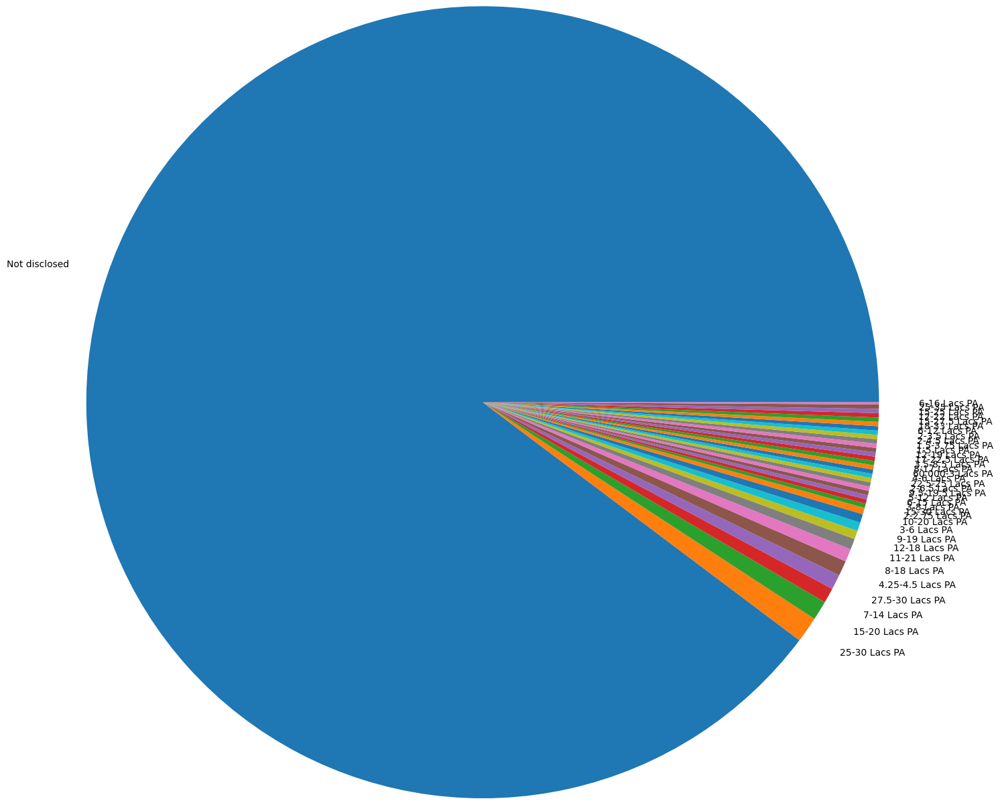

In [36]:
plt.pie(df3['Salary'].value_counts().values,labels=(df3['Salary'].value_counts().index),radius=4)

In [29]:
df3["Expereince"].value_counts()

5-10 Yrs     86
7-12 Yrs     82
8-13 Yrs     58
4-9 Yrs      58
3-6 Yrs      55
             ..
4-5 Yrs       2
15-17 Yrs     2
0-9 Yrs       2
3-12 Yrs      1
2-10 Yrs      1
Name: Expereince, Length: 73, dtype: int64

In [30]:
d5=df3.groupby("Expereince")

In [31]:
for i in df3["Expereince"]:
    g=d5.get_group(i)
   
    print(i)
    
    print(g)    

3-8 Yrs
                                                  Title  \
0                             Bpm Consultant- Pan India   
98                          Oracle Epm Consultant-Edmcs   
145                 Sharepoint Developer/SPFx Developer   
165            Hiring For Solution Designer / Architect   
171                  Senior Manager - Sales & Marketing   
176    Relationship Manager: Retail Banking (PAN India)   
178              Relationship Manager  Consumer Finance   
242         Genpact hiring For Automic admin/ developer   
246                                     System Engineer   
248           CN - Strategy - MC - Capital Markets - 11   
249           CN - Strategy - MC - Capital Markets - 09   
254           CN - Strategy - MC - Capital Markets - 07   
289                   SAP SD Consultant ( 3- 12 years )   
317   Job Opportunity  Informatica MDM(Profisee) Opp...   
360                                       Sales Officer   
385         Cognizant_MS Dynamics CRM 365_F&O Te

                                                  Title               Company  \
29                    Customer Care Executive || WFH ||  Teleperformance (TP)   
30     Opportunity with Deloitte India - Process Mining              Deloitte   
39    CN - Comms & Media - Private Networks - Consul...             Accenture   
40     CN - Comms & Media - Network Assurance - Analyst             Accenture   
41    CN - Comms & Media - Network Assurance - Consu...             Accenture   
74          CN - Comms & Media - Non Networks - Analyst             Accenture   
76       CN - Comms & Media - Non Networks - Consultant             Accenture   
122     CN - Comms & Media - Private Networks - Analyst             Accenture   
142                    Middle East English Professional                 BYJUS   
292      CN - CG&S - S4 Intelligent Functions - Analyst             Accenture   
349                                      Coach Cust Svc                 Sykes   
569                   Custom

2-5 Yrs
                                                  Title  \
68                        Supervisor Channel Operations   
121                                   Assistant Manager   
143                      Professional FT - Plant Health   
189                                            Engineer   
274   Data Science- Market Mix Modelling- Senior Ass...   
354                      Senior Statistical Programming   
361                       Senior statistical programmer   
407                          Automation Engineer 2 EMCS   
423                    Senior Clinical Research Monitor   
436                                           TEAM LEAD   
447                              SW Support Engineer II   
608                       Supervisor Channel Operations   
661                                   Assistant Manager   
683                      Professional FT - Plant Health   
729                                            Engineer   
814   Data Science- Market Mix Modelling- Senior

                                                 Title              Company  \
50                          Autosar Adaptive Architect         Hitachi Ltd.   
69                           Servicenow Developer ITSM            Capgemini   
93         Data Engineer - Senior Associate - P&T Labs                  PwC   
95               Scrum Master - Senior Associate - P&T                  PwC   
96                                       AEM DEVELOPER            Capgemini   
185  Informatica Data Quality Developer / Informati...            Cognizant   
233                        SAP Basis Hana Professional            Capgemini   
260                            Senior UiPath Developer            Cognizant   
280       Data Quality Engineer-Senior Associate (P&T)                  PwC   
309         Incident, Problem & Major Incident Manager            Capgemini   
324                          Servicenow ITSM Developer            Capgemini   
325                              React JS Profession

                                                  Title  \
8          Digital UX Lead (Figma) _ Tech M (PAN India)   
9                                        Perl Developer   
10    HCL Hiring Tibco BW 5.x , 6.x Development & Su...   
18    Job Opportunity For AWS Datalake with Hexaware!!!   
36           Software Package Creation Specialist (SWP)   
...                                                 ...   
1078                                 Senior Manager PPM   
1100                                      Presales Lead   
1123                   CitiusTech Hiring Java Developer   
1133  Sr. Manager (L5) - Opn. Plng, Import & Export ...   
1134                     Sr. Manager - Supplier Quality   

                    Company Expereince         Salary  \
8             Tech Mahindra   5-10 Yrs  15-20 Lacs PA   
9             Tech Mahindra   5-10 Yrs  Not disclosed   
10                  HCLTech   5-10 Yrs  Not disclosed   
18    Hexaware Technologies   5-10 Yrs  Not disclosed   
36    

                                                  Title  \
0                             Bpm Consultant- Pan India   
98                          Oracle Epm Consultant-Edmcs   
145                 Sharepoint Developer/SPFx Developer   
165            Hiring For Solution Designer / Architect   
171                  Senior Manager - Sales & Marketing   
176    Relationship Manager: Retail Banking (PAN India)   
178              Relationship Manager  Consumer Finance   
242         Genpact hiring For Automic admin/ developer   
246                                     System Engineer   
248           CN - Strategy - MC - Capital Markets - 11   
249           CN - Strategy - MC - Capital Markets - 09   
254           CN - Strategy - MC - Capital Markets - 07   
289                   SAP SD Consultant ( 3- 12 years )   
317   Job Opportunity  Informatica MDM(Profisee) Opp...   
360                                       Sales Officer   
385         Cognizant_MS Dynamics CRM 365_F&O Technical 

                                                 Title              Company  \
50                          Autosar Adaptive Architect         Hitachi Ltd.   
69                           Servicenow Developer ITSM            Capgemini   
93         Data Engineer - Senior Associate - P&T Labs                  PwC   
95               Scrum Master - Senior Associate - P&T                  PwC   
96                                       AEM DEVELOPER            Capgemini   
185  Informatica Data Quality Developer / Informati...            Cognizant   
233                        SAP Basis Hana Professional            Capgemini   
260                            Senior UiPath Developer            Cognizant   
280       Data Quality Engineer-Senior Associate (P&T)                  PwC   
309         Incident, Problem & Major Incident Manager            Capgemini   
324                          Servicenow ITSM Developer            Capgemini   
325                              React JS Profession

                                                  Title          Company  \
21             CN - Retail - SAP Platforms - Consultant        Accenture   
54                                    Team Lead - Sales            Paytm   
62                                    Customer Engineer  NCR Corporation   
127              Site Service Technical Manager - Gooty           Wabtec   
203   CN - Aerospace & Defense - SAP Platforms - Con...        Accenture   
205   CN - Sales Excellence - Graphic & Visual Desig...        Accenture   
206   CN - Sales Excellence - Graphic & Visual Desig...        Accenture   
207            CN - Retail - SAP Platforms - Consultant        Accenture   
208   CN - Sales Excellence - Graphic & Visual Desig...        Accenture   
209   CN - Sales Excellence - Topic Advisory - Assoc...        Accenture   
214                        Portfolio Support Specialist          Pearson   
216   CN - Sales Excellence - Topic Advisory - Consu...        Accenture   
245         

2-4 Yrs
                                                  Title  \
26       SAP Vendor Invoice Management Application Lead   
79                            Security Delivery Analyst   
91    CN - Strategy - MC- SC&O - S2P Tech & Org- S&P...   
190                                     Senior Engineer   
191                                     Senior Engineer   
211                                      Technical Lead   
244                                   Territory Manager   
250   CN- Strategy- MC- SC&O- S2P Tech & Org-Procure...   
269          CN - Strategy - MC - SC&O - S2P Tech & Org   
437                                            ENGINEER   
566      SAP Vendor Invoice Management Application Lead   
619                           Security Delivery Analyst   
631   CN - Strategy - MC- SC&O - S2P Tech & Org- S&P...   
730                                     Senior Engineer   
731                                     Senior Engineer   
751                                      Technic

                                                  Title  \
8          Digital UX Lead (Figma) _ Tech M (PAN India)   
9                                        Perl Developer   
10    HCL Hiring Tibco BW 5.x , 6.x Development & Su...   
18    Job Opportunity For AWS Datalake with Hexaware!!!   
36           Software Package Creation Specialist (SWP)   
...                                                 ...   
1078                                 Senior Manager PPM   
1100                                      Presales Lead   
1123                   CitiusTech Hiring Java Developer   
1133  Sr. Manager (L5) - Opn. Plng, Import & Export ...   
1134                     Sr. Manager - Supplier Quality   

                    Company Expereince         Salary  \
8             Tech Mahindra   5-10 Yrs  15-20 Lacs PA   
9             Tech Mahindra   5-10 Yrs  Not disclosed   
10                  HCLTech   5-10 Yrs  Not disclosed   
18    Hexaware Technologies   5-10 Yrs  Not disclosed   
36    

                                       Title    Company Expereince  \
31                                Splunk SME  Capgemini   9-12 Yrs   
118                                SAP Basis  Capgemini   9-12 Yrs   
231                      Azure AD Consultant  Capgemini   9-12 Yrs   
285  Aws DevOps & Cloud Formation Consultant  Capgemini   9-12 Yrs   
318                             GCP Engineer  Capgemini   9-12 Yrs   
328           ELK Implementer /Administrator  Capgemini   9-12 Yrs   
571                               Splunk SME  Capgemini   9-12 Yrs   
658                                SAP Basis  Capgemini   9-12 Yrs   
771                      Azure AD Consultant  Capgemini   9-12 Yrs   
825  Aws DevOps & Cloud Formation Consultant  Capgemini   9-12 Yrs   
858                             GCP Engineer  Capgemini   9-12 Yrs   
868           ELK Implementer /Administrator  Capgemini   9-12 Yrs   

            Salary                                           Location  \
31   Not disclos

                                                  Title  \
7     Pega Developer, Leads, Architects || PAN India...   
20                                 NEVA- NICE Developer   
70    Pega Developer, Leads, Architects || PAN India...   
97                                     EDR professional   
101                                      Java Developer   
150                                F5 Engineer (F5 APM)   
166                  Sap Fico Consultant( 2- 12 years )   
193                            Automation Test Engineer   
243                                      Java Developer   
247              Automotive Embedded Software Developer   
257    Manager, Global Incentive Compensation Analytics   
271              Scientific Business Manager - Oncology   
290                       Sap Abap Technical Consultant   
295                              Pricing & Deal Analyst   
300             SuccessFactors Consultant/Sr.Consultant   
306         C#.net||Web Form|| Job opening For Infogain 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                 Title     Company Expereince  \
6     Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
55    Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
276        Data Engineer-Associate-P&T         PwC    0-5 Yrs   
278             E-Relationship Manager  ICICI Bank    0-5 Yrs   
303  Assurance - CoE - Associate (FTH)         PwC    0-5 Yrs   
332          CSE Bulk Hiring-bangalore       2coms    0-5 Yrs   
486   Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
506   Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
526   Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
546   Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
595   Probationary Officers' Programme  ICICI Bank    0-5 Yrs   
816        Data Engineer-Associate-P&T         PwC    0-5 Yrs   
818             E-Relationship Manager  ICICI Bank    0-5 Yrs   
843  Assurance - CoE - Associate (FTH)         PwC    0-5 Yrs   
872          CSE Bulk Hir

                                                  Title  \
17    Matillion and Snowflake Developer with Hexawar...   
19                                      IT Technologist   
56                Senior Manager - SAP SuccessFactor EC   
104   CN - Strategy - MC - SC&O - SC Digital Core Ariba   
108   CN - Strategy - MC - SC&O - SC Digital Core Ar...   
116   Matillion and Snowflake Developer with Hexawar...   
126                                Technical Consultant   
137                                         BI Engineer   
139                                     IT Technologist   
149             Executive(L6) -Scheduling & Procurement   
155   Oracle Retail/Retek Functional Professional - ...   
174   CN - Health - Performance Improvement - Consul...   
175     CN - Health - Performance Improvement - Manager   
261                                    UiPath Developer   
268   Program Manager ( E-commerce ) - Supply Chain ...   
333     Hiring For Relationship Manager- Wealth Channel 

                                                  Title  \
17    Matillion and Snowflake Developer with Hexawar...   
19                                      IT Technologist   
56                Senior Manager - SAP SuccessFactor EC   
104   CN - Strategy - MC - SC&O - SC Digital Core Ariba   
108   CN - Strategy - MC - SC&O - SC Digital Core Ar...   
116   Matillion and Snowflake Developer with Hexawar...   
126                                Technical Consultant   
137                                         BI Engineer   
139                                     IT Technologist   
149             Executive(L6) -Scheduling & Procurement   
155   Oracle Retail/Retek Functional Professional - ...   
174   CN - Health - Performance Improvement - Consul...   
175     CN - Health - Performance Improvement - Manager   
261                                    UiPath Developer   
268   Program Manager ( E-commerce ) - Supply Chain ...   
333     Hiring For Relationship Manager- Wealth Channel 

                                                  Title  \
44      Sr Android Developer - Android, Kotlin, Mockito   
48                    SAP Database Administrator (Hana)   
81    CN - Strategy - MC - SC&O - SC Digital Core S4...   
83    CN - Strategy - MC - SC&O - SC Digital Core S4...   
99    CN - Strategy - MC - SC&O - SC Digital Core Or...   
105   CN - Strategy - MC - SC&O - SC Digital Core Or...   
113   CN - Strategy - MC - SC&O - SC Digital Core IB...   
130          Senior Manager (L5) - VATS Operations (PV)   
135                                      Technical Lead   
163               Hiring For Python, AWS, API Developer   
286   Guidewire Integration Developer-3-10Y-Bangalor...   
296   Urgent Opening For Oracle ATG or Endeca Developer   
304   Opening For .Net Developer@Bangalore/Pune/Mumb...   
341                  Senior Manager (L5) - Engineer C&C   
346     Assistant Manager - Detailed Engineering (Mech)   
362                       A&MS Layout Design Engr, Sr I 

                                                  Title  \
44      Sr Android Developer - Android, Kotlin, Mockito   
48                    SAP Database Administrator (Hana)   
81    CN - Strategy - MC - SC&O - SC Digital Core S4...   
83    CN - Strategy - MC - SC&O - SC Digital Core S4...   
99    CN - Strategy - MC - SC&O - SC Digital Core Or...   
105   CN - Strategy - MC - SC&O - SC Digital Core Or...   
113   CN - Strategy - MC - SC&O - SC Digital Core IB...   
130          Senior Manager (L5) - VATS Operations (PV)   
135                                      Technical Lead   
163               Hiring For Python, AWS, API Developer   
286   Guidewire Integration Developer-3-10Y-Bangalor...   
296   Urgent Opening For Oracle ATG or Endeca Developer   
304   Opening For .Net Developer@Bangalore/Pune/Mumb...   
341                  Senior Manager (L5) - Engineer C&C   
346     Assistant Manager - Detailed Engineering (Mech)   
362                       A&MS Layout Design Engr, Sr I 

                                                  Title              Company  \
16                           Rpa Project Manager UiPath                Wipro   
45    Techno Functional Manager - Techno Functional ...               Photon   
115                          Rpa Project Manager UiPath                Wipro   
156                   HCL TECH || .NET Architect Hiring              HCLTech   
158                  HCL TECH || Azure Architect Hiring              HCLTech   
221   CN - Strategy - MC - T&O - Change Management C...            Accenture   
224    CN - Strategy - MC - T&O - Graphic Designer - 09            Accenture   
434   Senior Manager-CCE LKW - Works Construction-CV...  Tata Motors Finance   
496                          Rpa Project Manager UiPath                Wipro   
516                          Rpa Project Manager UiPath                Wipro   
536                          Rpa Project Manager UiPath                Wipro   
556                          Rpa Project

2-8 Yrs
                                                  Title              Company  \
148       Senior Manager - Territory Sales Manager - PV  Tata Motors Finance   
404                                      Senior Manager  Tata Motors Finance   
443                         Executive(L6) - Warehousing  Tata Motors Finance   
467   Sr. Manager - Sales-Aggr.Bus.-Trailer Axles(East)  Tata Motors Finance   
688       Senior Manager - Territory Sales Manager - PV  Tata Motors Finance   
944                                      Senior Manager  Tata Motors Finance   
983                         Executive(L6) - Warehousing  Tata Motors Finance   
1007  Sr. Manager - Sales-Aggr.Bus.-Trailer Axles(East)  Tata Motors Finance   
1062                                     SQL Server DBA      NCR Corporation   

     Expereince         Salary  \
148     2-8 Yrs  Not disclosed   
404     2-8 Yrs  Not disclosed   
443     2-8 Yrs  Not disclosed   
467     2-8 Yrs  Not disclosed   
688     2-8 Yrs  Not 

                                                  Title  \
0                             Bpm Consultant- Pan India   
98                          Oracle Epm Consultant-Edmcs   
145                 Sharepoint Developer/SPFx Developer   
165            Hiring For Solution Designer / Architect   
171                  Senior Manager - Sales & Marketing   
176    Relationship Manager: Retail Banking (PAN India)   
178              Relationship Manager  Consumer Finance   
242         Genpact hiring For Automic admin/ developer   
246                                     System Engineer   
248           CN - Strategy - MC - Capital Markets - 11   
249           CN - Strategy - MC - Capital Markets - 09   
254           CN - Strategy - MC - Capital Markets - 07   
289                   SAP SD Consultant ( 3- 12 years )   
317   Job Opportunity  Informatica MDM(Profisee) Opp...   
360                                       Sales Officer   
385         Cognizant_MS Dynamics CRM 365_F&O Technical 

                                                  Title          Company  \
21             CN - Retail - SAP Platforms - Consultant        Accenture   
54                                    Team Lead - Sales            Paytm   
62                                    Customer Engineer  NCR Corporation   
127              Site Service Technical Manager - Gooty           Wabtec   
203   CN - Aerospace & Defense - SAP Platforms - Con...        Accenture   
205   CN - Sales Excellence - Graphic & Visual Desig...        Accenture   
206   CN - Sales Excellence - Graphic & Visual Desig...        Accenture   
207            CN - Retail - SAP Platforms - Consultant        Accenture   
208   CN - Sales Excellence - Graphic & Visual Desig...        Accenture   
209   CN - Sales Excellence - Topic Advisory - Assoc...        Accenture   
214                        Portfolio Support Specialist          Pearson   
216   CN - Sales Excellence - Topic Advisory - Consu...        Accenture   
245         

                                                  Title  \
0                             Bpm Consultant- Pan India   
98                          Oracle Epm Consultant-Edmcs   
145                 Sharepoint Developer/SPFx Developer   
165            Hiring For Solution Designer / Architect   
171                  Senior Manager - Sales & Marketing   
176    Relationship Manager: Retail Banking (PAN India)   
178              Relationship Manager  Consumer Finance   
242         Genpact hiring For Automic admin/ developer   
246                                     System Engineer   
248           CN - Strategy - MC - Capital Markets - 11   
249           CN - Strategy - MC - Capital Markets - 09   
254           CN - Strategy - MC - Capital Markets - 07   
289                   SAP SD Consultant ( 3- 12 years )   
317   Job Opportunity  Informatica MDM(Profisee) Opp...   
360                                       Sales Officer   
385         Cognizant_MS Dynamics CRM 365_F&O Technical 

                                                  Title  \
44      Sr Android Developer - Android, Kotlin, Mockito   
48                    SAP Database Administrator (Hana)   
81    CN - Strategy - MC - SC&O - SC Digital Core S4...   
83    CN - Strategy - MC - SC&O - SC Digital Core S4...   
99    CN - Strategy - MC - SC&O - SC Digital Core Or...   
105   CN - Strategy - MC - SC&O - SC Digital Core Or...   
113   CN - Strategy - MC - SC&O - SC Digital Core IB...   
130          Senior Manager (L5) - VATS Operations (PV)   
135                                      Technical Lead   
163               Hiring For Python, AWS, API Developer   
286   Guidewire Integration Developer-3-10Y-Bangalor...   
296   Urgent Opening For Oracle ATG or Endeca Developer   
304   Opening For .Net Developer@Bangalore/Pune/Mumb...   
341                  Senior Manager (L5) - Engineer C&C   
346     Assistant Manager - Detailed Engineering (Mech)   
362                       A&MS Layout Design Engr, Sr I 

                                             Title                  Company  \
267        Principal Engineering Manager - Ad Tech  The Walt Disney Company   
313                          Integration Architect    Hexaware Technologies   
381               Hiring For Google Data Architect            Tech Mahindra   
807        Principal Engineering Manager - Ad Tech  The Walt Disney Company   
853                          Integration Architect    Hexaware Technologies   
921               Hiring For Google Data Architect            Tech Mahindra   
1126  Sub-Module Team Leader (SMTL) - Software V&V      Tata Motors Finance   

     Expereince         Salary  \
267   15-20 Yrs  Not disclosed   
313   15-20 Yrs  15-30 Lacs PA   
381   15-20 Yrs  Not disclosed   
807   15-20 Yrs  Not disclosed   
853   15-20 Yrs  15-30 Lacs PA   
921   15-20 Yrs  Not disclosed   
1126  15-20 Yrs  Not disclosed   

                                               Location  \
267                         Mumbai,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                  Title              Company  \
89    SAP Ariba Cloud Integration Gateway CIG Applic...            Accenture   
102                      Urgent Hiring | .Net Developer             Infogain   
123                                     Design Engineer   Schneider Electric   
184                    Digital Solutions - .NET Support  TELUS International   
227                    Analystics & Modeling Specialist            Accenture   
241                              IDAM Technical Analyst              HCLTech   
305                                 Snowflake Developer             Infogain   
334               Sr Mgr - CV P&SC IT Digital Marketing  Tata Motors Finance   
466   Senior Manager - Project Planning and Executio...  Tata Motors Finance   
629   SAP Ariba Cloud Integration Gateway CIG Applic...            Accenture   
642                      Urgent Hiring | .Net Developer             Infogain   
663                                     

                                                  Title  \
49                               Technical Support Lead   
61                           TSI-Del-Met-2 Professional   
131               Senior Manager (L5) - TCF Maintenance   
153   Oracle Cloud SCM Functional Professional's - M...   
210                        Technical Specialist UI Path   
275                               Data Science- Manager   
337   Senior Manager(L5) - Std- Customer Support Man...   
352     Senior Manager (L5) - Cost Engineering Delivery   
356                                     Devops Engineer   
389                Area Parts Manager - Service Network   
408                                N & T Radio Designer   
461                             Sr.Manager-Mechatronics   
589                              Technical Support Lead   
601                          TSI-Del-Met-2 Professional   
671               Senior Manager (L5) - TCF Maintenance   
693   Oracle Cloud SCM Functional Professional's - M... 

                                                  Title  \
15                    Azure Data Factory Developer -ADF   
33     Senior Manager - Territory Sales Manager - ILMCV   
53                    Senior Manager - TSM CV Passenger   
57           Senior Manager - Regional Sales - New Cars   
92                                            Associate   
114                   Azure Data Factory Developer -ADF   
182           Digital Solutions - Postgre SQL Developer   
188                                        Project Lead   
336                           Senior Manager(L5)_Safety   
449                        Assistant Manager - CPD(STL)   
463          Senior Mgr - CQ - Electrical & Electronics   
469                          Lead - Purchase Powertrain   
495                   Azure Data Factory Developer -ADF   
515                   Azure Data Factory Developer -ADF   
535                   Azure Data Factory Developer -ADF   
555                   Azure Data Factory Developer -ADF 

                                                  Title  \
68                        Supervisor Channel Operations   
121                                   Assistant Manager   
143                      Professional FT - Plant Health   
189                                            Engineer   
274   Data Science- Market Mix Modelling- Senior Ass...   
354                      Senior Statistical Programming   
361                       Senior statistical programmer   
407                          Automation Engineer 2 EMCS   
423                    Senior Clinical Research Monitor   
436                                           TEAM LEAD   
447                              SW Support Engineer II   
608                       Supervisor Channel Operations   
661                                   Assistant Manager   
683                      Professional FT - Plant Health   
729                                            Engineer   
814   Data Science- Market Mix Modelling- Senior Ass... 

([<matplotlib.patches.Wedge at 0x22d5dfc8310>,
 [Text(3.2077562061107927, 0.7747903730414423, '5-10 Yrs'),
  Text(2.524045339172164, 2.1258398636311435, '7-12 Yrs'),
  Text(1.538539559787642, 2.9193999422772565, '8-13 Yrs'),
  Text(0.5431621519363481, 3.2549923005598456, '4-9 Yrs'),
  Text(-0.48027457750999175, 3.2648639068416925, '3-6 Yrs'),
  Text(-1.4247893238475666, 2.9765710780443317, '3-8 Yrs'),
  Text(-2.18096448229998, 2.476568982876508, '2-7 Yrs'),
  Text(-2.7014618665184025, 1.8952846181370524, '4-8 Yrs'),
  Text(-3.043556184668939, 1.2754472747877332, '5-8 Yrs'),
  Text(-3.2334490058328536, 0.6593993681211205, '4-7 Yrs'),
  Text(-3.2991980702395214, 0.07274677537747253, '6-9 Yrs'),
  Text(-3.2635279712971546, -0.48927004870631413, '3-7 Yrs'),
  Text(-3.138486499000184, -1.0197560961296421, '3-5 Yrs'),
  Text(-2.9444389822396886, -1.4900600927034144, '2-5 Yrs'),
  Text(-2.711866781749542, -1.880366602033599, '1-6 Yrs'),
  Text(-2.4401704548987557, -2.2216138618218966, '8-12 Y

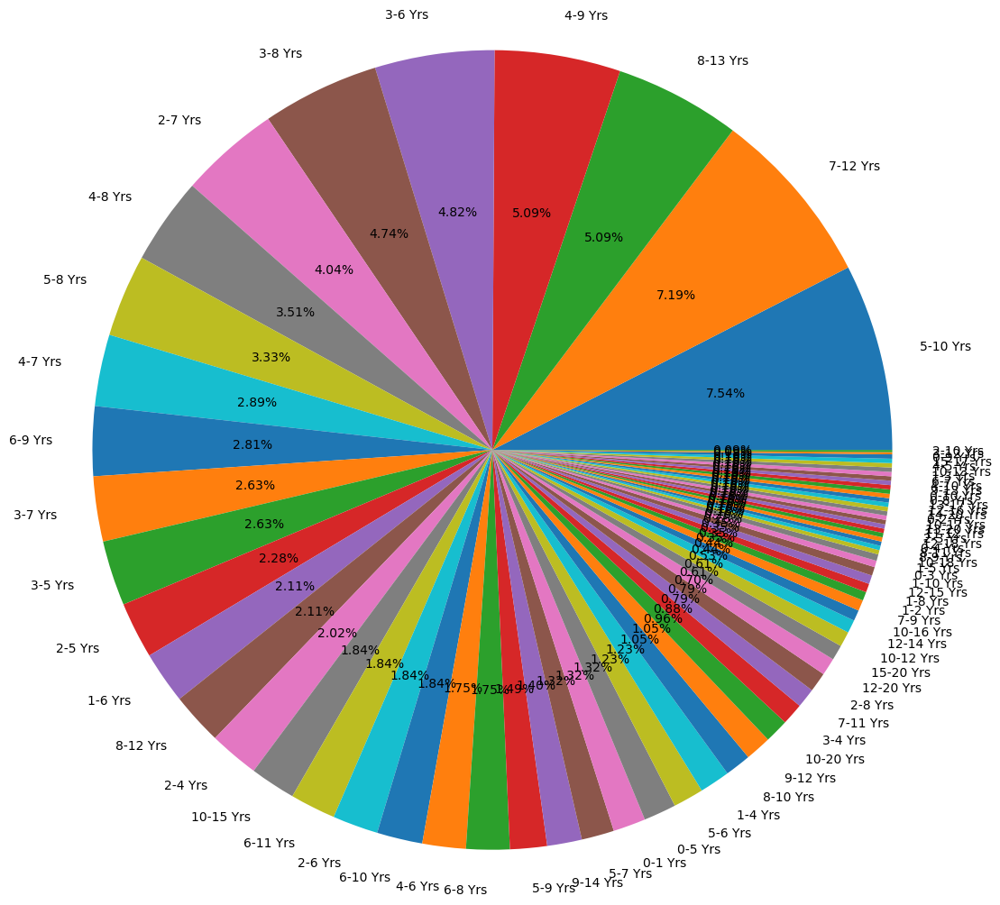

In [32]:
plt.pie(df3['Expereince'].value_counts().values,labels=(df3['Expereince'].value_counts().index),autopct='%0.2f%%',radius=3)

In [33]:
d=pd.crosstab(df3["Title"],df3["Company"])

In [34]:
print(d)

Company                         2coms  ABP Empower  ALSTOM India Limited  \
Title                                                                      
.Net Full Stack Developer           0            0                     0   
A&MS Circuit Design Engr, Sr I      0            0                     0   
A&MS Layout Design Engr, Sr I       0            0                     0   
AEM DEVELOPER                       0            0                     0   
AGM - Channel Sales                 0            0                     0   
...                               ...          ...                   ...   
Vehicle Delivery Manager            0            0                     0   
Vuejs Angular Developer             0            1                     0   
Vulnerability Management SME        0            0                     0   
Workday Functional Specialist       0            0                     0   
Workday Technical Specialist        0            0                     0   

Company    

In [35]:
dd1=pd.crosstab(df3["Company"],df3["Salary"],margins=True)
print(dd1)

Salary                1-5 Lacs PA  1.5-3.75 Lacs PA  10-20 Lacs PA  \
Company                                                              
2coms                           0                 0              0   
ABP Empower                     0                 0              0   
ALSTOM India Limited            0                 0              0   
Accenture                       0                 0              0   
Airtel                          0                 0              0   
...                           ...               ...            ...   
Vodafone Idea (Vi)              0                 0              0   
WNS Holdings                    0                 0              0   
Wabtec                          0                 0              0   
Wipro                           0                 0              0   
All                             2                 2              3   

Salary                11-21 Lacs PA  12-18 Lacs PA  12-19 Lacs PA  \
Company             

In [36]:
dd2=pd.crosstab(df3["Company"],df3["Salary"],normalize=True,margins=True)
print(dd2)

Salary                1-5 Lacs PA  1.5-3.75 Lacs PA  10-20 Lacs PA  \
Company                                                              
2coms                    0.000000          0.000000       0.000000   
ABP Empower              0.000000          0.000000       0.000000   
ALSTOM India Limited     0.000000          0.000000       0.000000   
Accenture                0.000000          0.000000       0.000000   
Airtel                   0.000000          0.000000       0.000000   
...                           ...               ...            ...   
Vodafone Idea (Vi)       0.000000          0.000000       0.000000   
WNS Holdings             0.000000          0.000000       0.000000   
Wabtec                   0.000000          0.000000       0.000000   
Wipro                    0.000000          0.000000       0.000000   
All                      0.001754          0.001754       0.002632   

Salary                11-21 Lacs PA  12-18 Lacs PA  12-19 Lacs PA  \
Company             

In [37]:
import matplotlib.pyplot as plt
import squarify

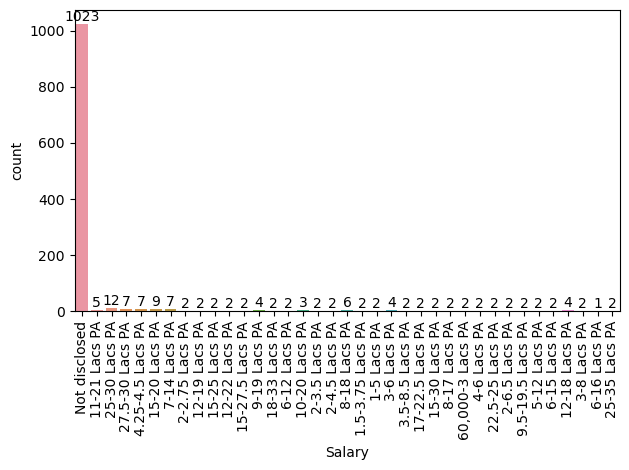

In [38]:
import seaborn as sns
a=sns.countplot(data=df3,x=df3["Salary"])
for i in a.containers:
    a.bar_label(i)
    plt.xticks(rotation=90)
plt.tight_layout()

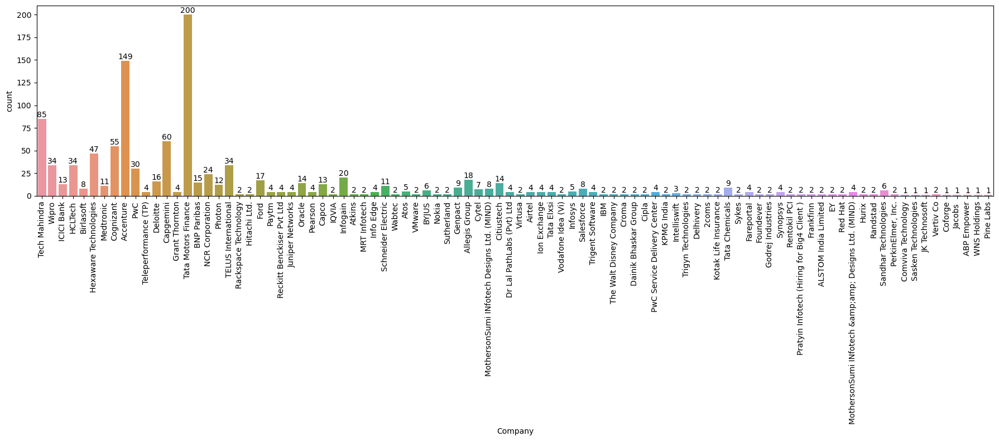

In [39]:

fig,ax=plt.subplots(figsize=(18,8))
a=sns.countplot(data=df3,x=df3["Company"],ax=ax)
for i in a.containers:
    a.bar_label(i)
    plt.xticks(rotation=90)
    
plt.tight_layout()

In [59]:
fig=px.pie(df3,"Salary",color="Company")
fig.show()

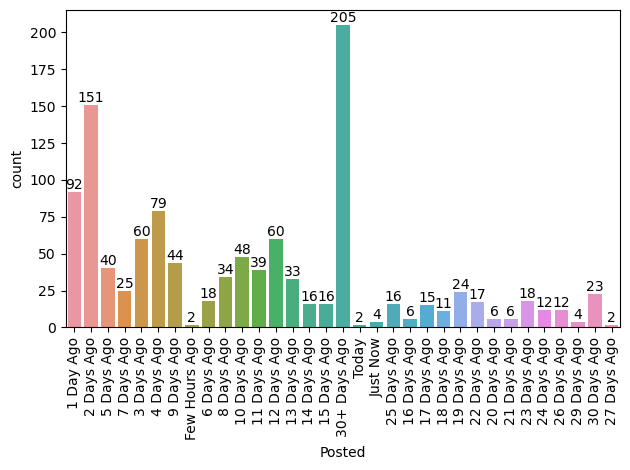

In [60]:

a=sns.countplot(data=df3,x=df3["Posted"])
for i in a.containers:
    a.bar_label(i)
    plt.xticks(rotation=90)
    
plt.tight_layout()

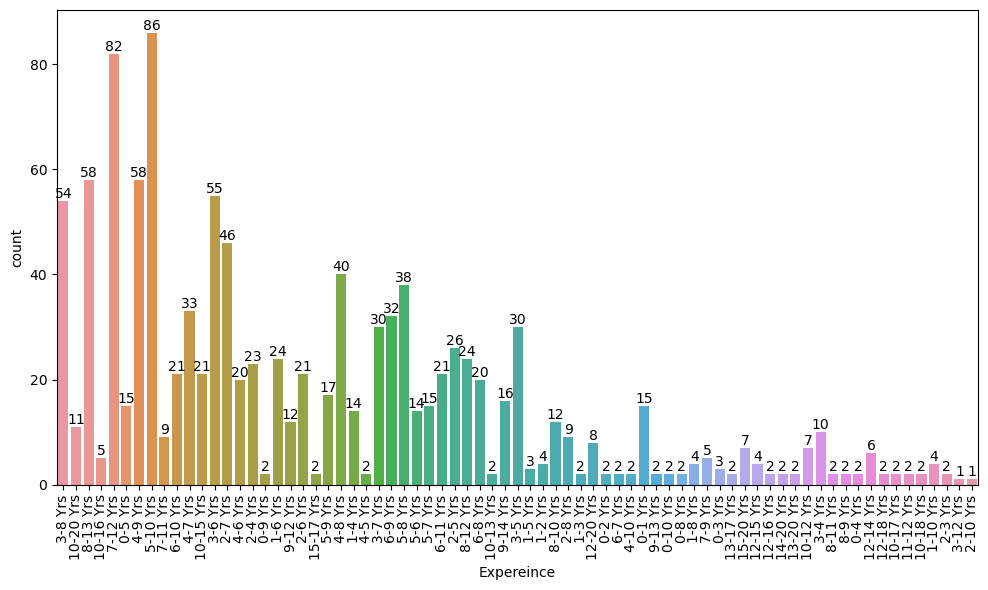

In [61]:

fig,ax=plt.subplots(figsize=(10,6))
a=sns.countplot(data=df3,x=df3["Expereince"],ax=ax)
for i in a.containers:
    a.bar_label(i)
    plt.xticks(rotation=90)
    
plt.tight_layout()

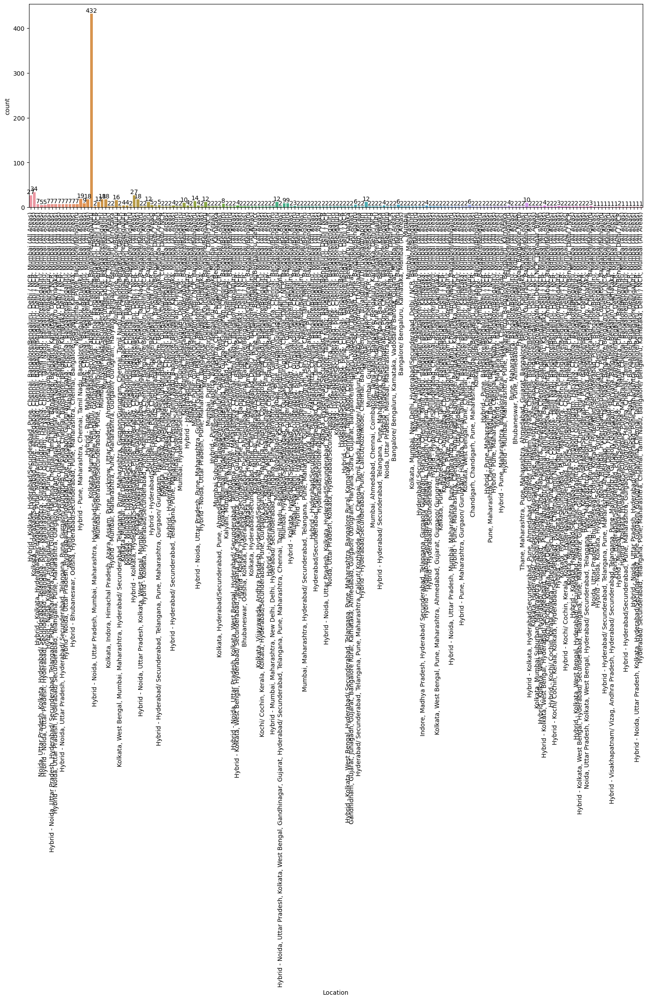

In [62]:
fig,ax=plt.subplots(figsize=(18,6))
a=sns.countplot(data=df3,x=df3["Location"])
for i in a.containers:
    a.bar_label(i)
    plt.xticks(rotation=90)
    
#plt.tight_layout()

In [64]:
fig=px.pie(df3,"Title",color="Title")
fig.show()

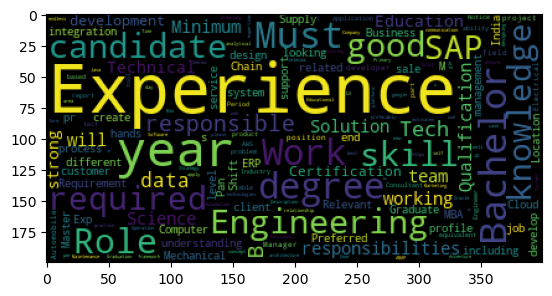

In [106]:
t1=" ".join(q for q in df3.Qualification)
w1=WordCloud(collocations=False).generate(t1)
plt.imshow(w1)
plt.show()

In [65]:

d5=df3.loc[(df3["Title"]=="Data Engineer" ) | (df3["Title"]=="Data Science- Manager")| (df3["Title"]=="Data Engineer-Associate-P&T" )| (df3["Title"]=="Data Governance-Data Management") | (df3["Title"]=="Data Engineer - Manager - P&T Labs") |(df3["Title"]=="Senior Data Analyst- (Python & Pyspark)") | (df3["Title"]=="Analyst, Global Incentive Compensation Analytics")|(df3["Title"]=='Data Science - Market Mix Modelling - Senior Associate 2 - ANI')|
       (df3["Title"]=='Data Science - Market Mix Modelling - Associate 2- ANI')|(df3["Title"]=='Data Science- Market Mix Modelling- Senior Associate - ANI')|(df3["Title"]=='Data Science- Manager')|(df3["Title"]=='Data Engineer-Associate-P&T')]

In [66]:
d5

,Title,Company,Expereince,Salary,Location,Qualification,Posted
82,Data Governance-Data Management,Capco,7-12 Yrs,Not disclosed,"Hybrid - Hyderabad/ Secunderabad, Telangana, P...",Experience required: 7+ years . Notice Period...,3 Days Ago
94,Data Engineer - Manager - P&T Labs,PwC,10-13 Yrs,Not disclosed,"Mumbai, Hyderabad/Secunderabad, Bangalore/Beng...",Knowledge of batch and streaming data process...,1 Day Ago
195,Senior Data Analyst- (Python & Pyspark),Capco,7-12 Yrs,Not disclosed,"Hybrid - Mumbai, Maharashtra, New Delhi, Delhi...",About UsJoining Capco means joining an organi...,9 Days Ago
258,"Analyst, Global Incentive Compensation Analytics",Salesforce,2-6 Yrs,Not disclosed,"Hyderabad/Secunderabad, Pune, Bangalore/Bengaluru",- Develop and deliver monthly/quarterly dashb...,2 Days Ago
272,Data Science - Market Mix Modelling - Senior A...,PwC,6-11 Yrs,Not disclosed,"Kolkata, Mumbai, Hyderabad/Secunderabad, Banga...","Solid knowledge and experience of supervised,...",6 Days Ago
273,Data Science - Market Mix Modelling - Associat...,PwC,2-7 Yrs,Not disclosed,"Kolkata, Mumbai, Hyderabad/Secunderabad, Banga...","At PwC, experienced Associates will work as a...",3 Days Ago
274,Data Science- Market Mix Modelling- Senior Ass...,PwC,2-5 Yrs,Not disclosed,"Kolkata, Mumbai, Hyderabad/Secunderabad, Banga...","At PwC, Senior Associate s will work as an in...",4 Days Ago
275,Data Science- Manager,PwC,3-7 Yrs,Not disclosed,"Kolkata, Mumbai, Hyderabad/Secunderabad, Banga...","Solid knowledge and experience of supervised,...",5 Days Ago
276,Data Engineer-Associate-P&T,PwC,0-5 Yrs,Not disclosed,"Mumbai, Hyderabad/Secunderabad, Bangalore/Beng...",Understanding architectural design and data p...,8 Days Ago
307,Data Engineer,Intelliswift,4-9 Yrs,8-18 Lacs PA,"Hybrid - Pune, Maharashtra, Chennai, Bangalore...","Dear Candidate, Greetings from Intelliswift S...",3 Days Ago


In [67]:
d5.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20 entries, 82 to 847
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Title          20 non-null     object
 1   Company        20 non-null     object
 2   Expereince     20 non-null     object
 3   Salary         20 non-null     object
 4   Location       20 non-null     object
 5   Qualification  20 non-null     object
 6   Posted         20 non-null     object
dtypes: object(7)
memory usage: 1.2+ KB


In [68]:
d5.isna().sum()

Title            0
Company          0
Expereince       0
Salary           0
Location         0
Qualification    0
Posted           0
dtype: int64

In [69]:
d5.describe()

,Title,Company,Expereince,Salary,Location,Qualification,Posted
count,20,20,20,20,20,20,20
unique,10,4,9,2,6,9,8
top,Data Governance-Data Management,PwC,7-12 Yrs,Not disclosed,"Kolkata, Mumbai, Hyderabad/Secunderabad, Banga...","Solid knowledge and experience of supervised,...",3 Days Ago
freq,2,12,4,18,8,4,6


In [70]:
d5["Title"].value_counts()

Data Governance-Data Management                                   2
Data Engineer - Manager - P&T Labs                                2
Senior Data Analyst- (Python & Pyspark)                           2
Analyst, Global Incentive Compensation Analytics                  2
Data Science - Market Mix Modelling - Senior Associate 2 - ANI    2
Data Science - Market Mix Modelling - Associate 2- ANI            2
Data Science- Market Mix Modelling- Senior Associate - ANI        2
Data Science- Manager                                             2
Data Engineer-Associate-P&T                                       2
Data Engineer                                                     2
Name: Title, dtype: int64

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'Data Governance-Data Management'),
  Text(1, 0, 'Data Engineer - Manager - P&T Labs'),
  Text(2, 0, 'Senior Data Analyst- (Python & Pyspark)'),
  Text(3, 0, 'Analyst, Global Incentive Compensation Analytics'),
  Text(4, 0, 'Data Science - Market Mix Modelling - Senior Associate 2 - ANI'),
  Text(5, 0, 'Data Science - Market Mix Modelling - Associate 2- ANI'),
  Text(6, 0, 'Data Science- Market Mix Modelling- Senior Associate - ANI'),
  Text(7, 0, 'Data Science- Manager'),
  Text(8, 0, 'Data Engineer-Associate-P&T'),
  Text(9, 0, 'Data Engineer')])

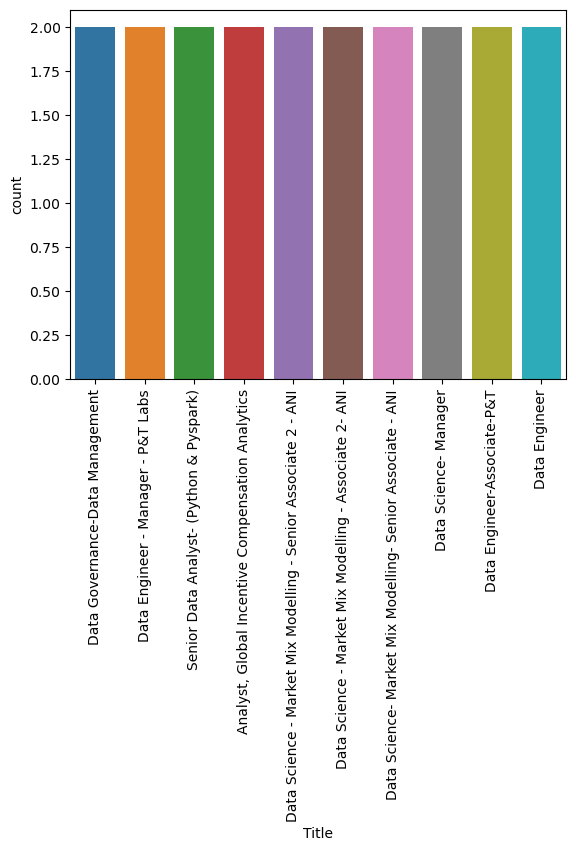

In [71]:
sns.countplot(data=d5,x=d5["Title"])
plt.xticks(rotation=90)

In [72]:
d5["Company"].value_counts()

PwC             12
Capco            4
Salesforce       2
Intelliswift     2
Name: Company, dtype: int64

(array([0, 1, 2, 3]),
 [Text(0, 0, 'Capco'),
  Text(1, 0, 'PwC'),
  Text(2, 0, 'Salesforce'),
  Text(3, 0, 'Intelliswift')])

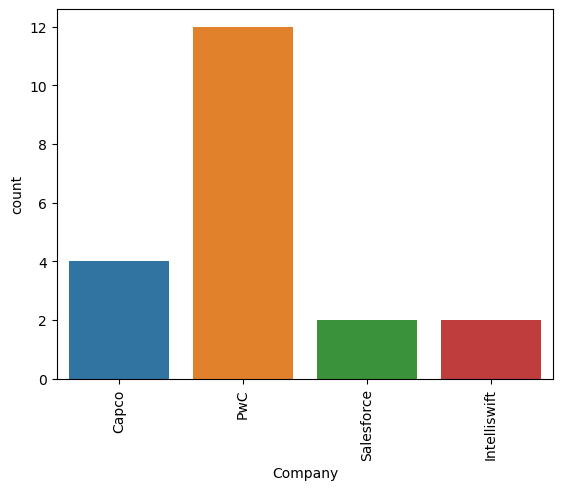

In [93]:
sns.countplot(data=d5,x=d5["Company"])
plt.xticks(rotation=90)

In [78]:
d5["Expereince"].value_counts()

7-12 Yrs     4
10-13 Yrs    2
2-6 Yrs      2
6-11 Yrs     2
2-7 Yrs      2
2-5 Yrs      2
3-7 Yrs      2
0-5 Yrs      2
4-9 Yrs      2
Name: Expereince, dtype: int64

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, '7-12 Yrs'),
  Text(1, 0, '10-13 Yrs'),
  Text(2, 0, '2-6 Yrs'),
  Text(3, 0, '6-11 Yrs'),
  Text(4, 0, '2-7 Yrs'),
  Text(5, 0, '2-5 Yrs'),
  Text(6, 0, '3-7 Yrs'),
  Text(7, 0, '0-5 Yrs'),
  Text(8, 0, '4-9 Yrs')])

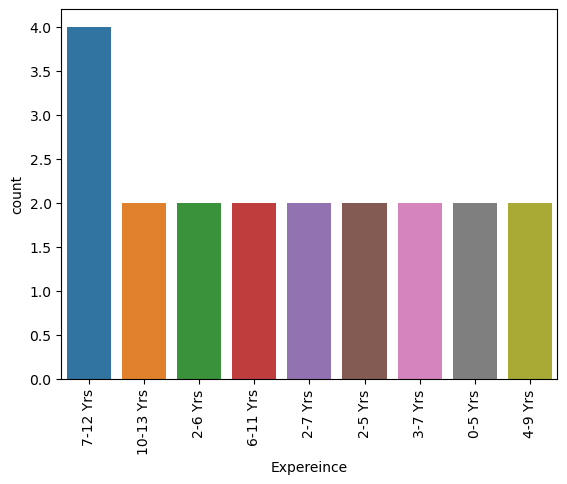

In [94]:
sns.countplot(data=d5,x=d5["Expereince"])
plt.xticks(rotation=90)

In [79]:

d5["Location"].value_counts()

Kolkata, Mumbai, Hyderabad/Secunderabad, Bangalore/Bengaluru                                                                                                            8
Mumbai, Hyderabad/Secunderabad, Bangalore/Bengaluru                                                                                                                     4
Hybrid - Hyderabad/ Secunderabad, Telangana, Pune, Maharashtra, Gurgaon/ Gurugram, Haryana, Chennai, Tamil Nadu, Bangalore/ Bengaluru, Karnataka, Mumbai (All Areas)    2
Hybrid - Mumbai, Maharashtra, New Delhi, Delhi, Hyderabad/ Secunderabad, Telangana, Pune, Maharashtra, Gurgaon/ Gurugram, Haryana, Chennai, Bangalore/Bengaluru         2
Hyderabad/Secunderabad, Pune, Bangalore/Bengaluru                                                                                                                       2
Hybrid - Pune, Maharashtra, Chennai, Bangalore/Bengaluru, Delhi / NCR, Mumbai (All Areas)                                                             

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'Hybrid - Hyderabad/ Secunderabad, Telangana, Pune, Maharashtra, Gurgaon/ Gurugram, Haryana, Chennai, Tamil Nadu, Bangalore/ Bengaluru, Karnataka, Mumbai (All Areas)'),
  Text(1, 0, 'Mumbai, Hyderabad/Secunderabad, Bangalore/Bengaluru'),
  Text(2, 0, 'Hybrid - Mumbai, Maharashtra, New Delhi, Delhi, Hyderabad/ Secunderabad, Telangana, Pune, Maharashtra, Gurgaon/ Gurugram, Haryana, Chennai, Bangalore/Bengaluru'),
  Text(3, 0, 'Hyderabad/Secunderabad, Pune, Bangalore/Bengaluru'),
  Text(4, 0, 'Kolkata, Mumbai, Hyderabad/Secunderabad, Bangalore/Bengaluru'),
  Text(5, 0, 'Hybrid - Pune, Maharashtra, Chennai, Bangalore/Bengaluru, Delhi / NCR, Mumbai (All Areas)')])

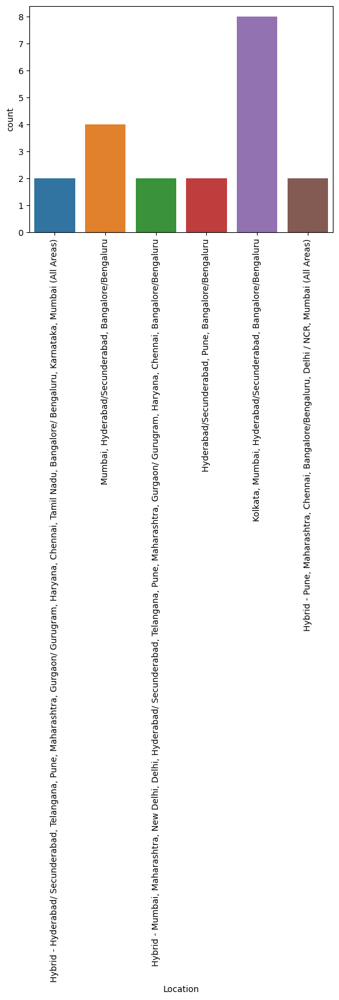

In [95]:
sns.countplot(data=d5,x=d5["Location"])
plt.xticks(rotation=90)

In [80]:
d5["Salary"].value_counts()

Not disclosed    18
8-18 Lacs PA      2
Name: Salary, dtype: int64

(array([0, 1]), [Text(0, 0, 'Not disclosed'), Text(1, 0, '8-18 Lacs PA')])

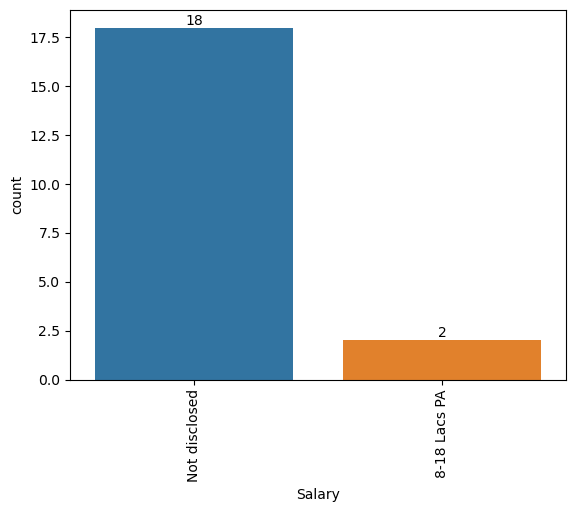

In [99]:
a=sns.countplot(data=d5,x=d5["Salary"])
for i in a.containers:
    a.bar_label(i)
plt.xticks(rotation=90)

In [81]:
d5["Posted"].value_counts()

3 Days Ago    6
1 Day Ago     2
9 Days Ago    2
2 Days Ago    2
6 Days Ago    2
4 Days Ago    2
5 Days Ago    2
8 Days Ago    2
Name: Posted, dtype: int64

(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, '3 Days Ago'),
  Text(1, 0, '1 Day Ago'),
  Text(2, 0, '9 Days Ago'),
  Text(3, 0, '2 Days Ago'),
  Text(4, 0, '6 Days Ago'),
  Text(5, 0, '4 Days Ago'),
  Text(6, 0, '5 Days Ago'),
  Text(7, 0, '8 Days Ago')])

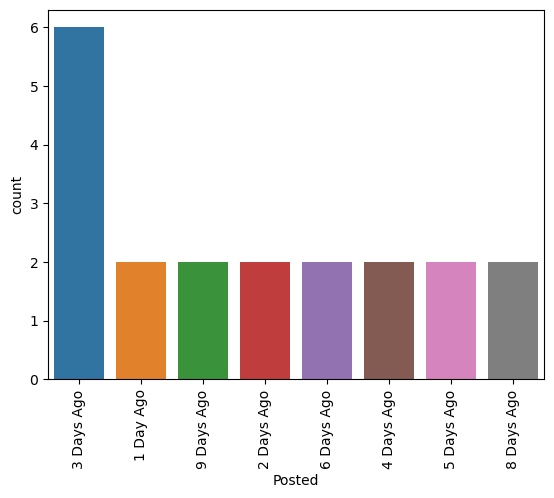

In [100]:
sns.countplot(data=d5,x=d5["Posted"])
plt.xticks(rotation=90)

In [83]:
d5["Qualification"].value_counts()

 Solid knowledge and experience of supervised, unsupervised machine learning algorithms....    4
 Experience required: 7+ years . Notice Period: Immediate to 1 Month                           2
 Knowledge of batch and streaming data processing techniques . Understanding of the Data...    2
 About UsJoining Capco means joining an organization that is committed to an inclusive w...    2
 - Develop and deliver monthly/quarterly dashboards and report to finance on commission ...    2
 At PwC, experienced Associates will work as an integral part of business analytics team...    2
 At PwC, Senior Associate s will work as an integral part of business analytics teams in...    2
 Understanding architectural design and data platform delivery in technologies that incl...    2
 Dear Candidate, Greetings from Intelliswift Software India Pvt. Ltd.We have an opening ...    2
Name: Qualification, dtype: int64

In [102]:
import wordcloud
from wordcloud import WordCloud

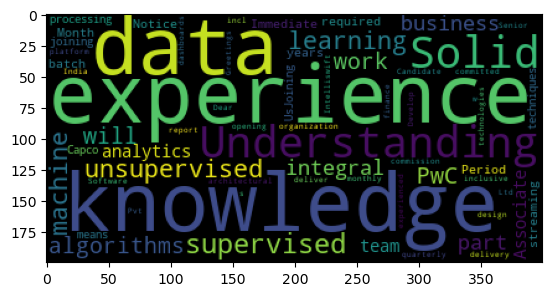

In [104]:
t=" ".join(q for q in d5.Qualification)
w=WordCloud(collocations=False).generate(t)
plt.imshow(w)
plt.show()

In [107]:
import squarify

<Axes: >

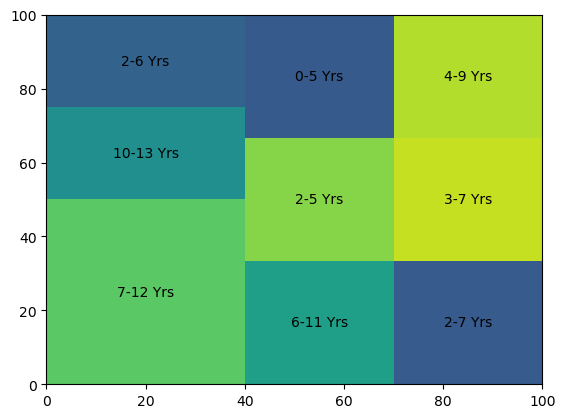

In [116]:
squarify.plot(sizes=d5["Expereince"].value_counts(),label=d5["Expereince"].value_counts().index)


<Axes: >

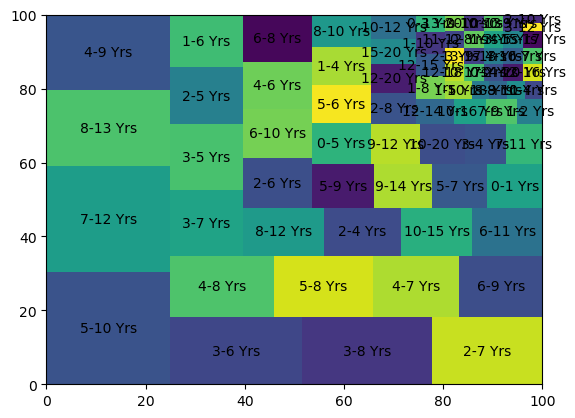

In [117]:

squarify.plot(sizes=df3["Expereince"].value_counts(),label=df3["Expereince"].value_counts().index)
